In [3]:
import torchvision 
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# load a model pre-trained pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

# replace the classifier with a new one, that has
# num_classes which is user-defined
num_classes = 4  # 3 class (vehicles) + background
# get number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features
# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
model.eval().summary()

AttributeError: 'FasterRCNN' object has no attribute 'summary'

In [5]:
import torch
import cv2
import numpy as np
import json
import pandas as pd
import seaborn as sns
import torchvision.transforms as T
import torch.nn.functional as F
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm


KeyboardInterrupt: 

In [68]:
def ftuple_to_ituple(tup):
    l = [int(i) for i in tup]
    return tuple(l)
        

def get_prediction(img_path, threshold):
    """
    get_prediction
    parameters:
      - img_path - path of the input image
      - threshold - threshold value for prediction score
    method:
      - Image is obtained from the image path
      - the image is converted to image tensor using PyTorch's Transforms
      - image is passed through the model to get the predictions
      - class, box coordinates are obtained, but only prediction score > threshold
        are chosen.
    """
    img = Image.open(img_path)
    transform = T.Compose([T.ToTensor()])
    img = transform(img)
    pred = model([img])
    pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())]
    pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())]
    pred_score = list(pred[0]['scores'].detach().numpy())
    pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
    pred_boxes = pred_boxes[:pred_t+1]
    pred_class = pred_class[:pred_t+1]
    return pred_boxes, pred_class

def object_detection_api(img_path, threshold=0.5, rect_th=3, text_size=3, text_th=3):
    boxes, pred_cls = get_prediction(img_path, threshold)
    # Get predictions
    img = cv2.imread(img_path)
    # Read image with cv2
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Convert to RGB
    for i in range(len(boxes)):
        cv2.rectangle(img, ftuple_to_ituple(boxes[i][0]), ftuple_to_ituple(boxes[i][1]),color=(0, 255, 0), thickness=rect_th)
        # Draw Rectangle with the coordinates
        cv2.putText(img, pred_cls[i], ftuple_to_ituple(boxes[i][0]), cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=text_th)
        # Write the prediction class
    plt.figure(figsize=(4,6))
    # display the output image
    plt.imshow(img) 
    plt.xticks([]) 
    plt.yticks([]) 
    plt.show()
    #img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    #video_writer.write(img)

In [62]:
COCO_INSTANCE_CATEGORY_NAMES = ['__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 
                                'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 
                                'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 
                                'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 
                                'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 
                                'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 
                                'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass', 
                                'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 
                                'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 
                                'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A', 
                                'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 
                                'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 
                                'N/A', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 
                                'toothbrush']

COCO_INSTANCE_CATEGORY_VEHICLES = ['__background__', 'bicycle', 'car', 'motorcycle', 
                                'bus', 'truck', 'traffic light']

COCO_INSTANCE_CATEGORY_VEHICLES_INDEX = [0,2,3,4,6,8,10]

In [ ]:
#!wget https://hips.hearstapps.com/hmg-prod.s3.amazonaws.com/images/10best-cars-group-cropped-1542126037.jpg -O car.jpg 
object_detection_api('./car.jpg', rect_th=6, text_th=5, text_size=5)

In [ ]:
#!wget https://cdn.pixabay.com/photo/2013/07/05/01/08/traffic-143391_960_720.jpg -O traffic.jpg 
object_detection_api('./traffic.jpg', rect_th=2, text_th=1, text_size=1)

In [ ]:
#!wget https://images.unsplash.com/photo-1458169495136-854e4c39548a -O girl_cars.jpg 
object_detection_api('./girl_cars.jpg', rect_th=15, text_th=7, text_size=5, threshold=0.8)

## Test with video

In [6]:
# Simply view the video
from IPython.display import Video

Video("videoplayback.mp4")

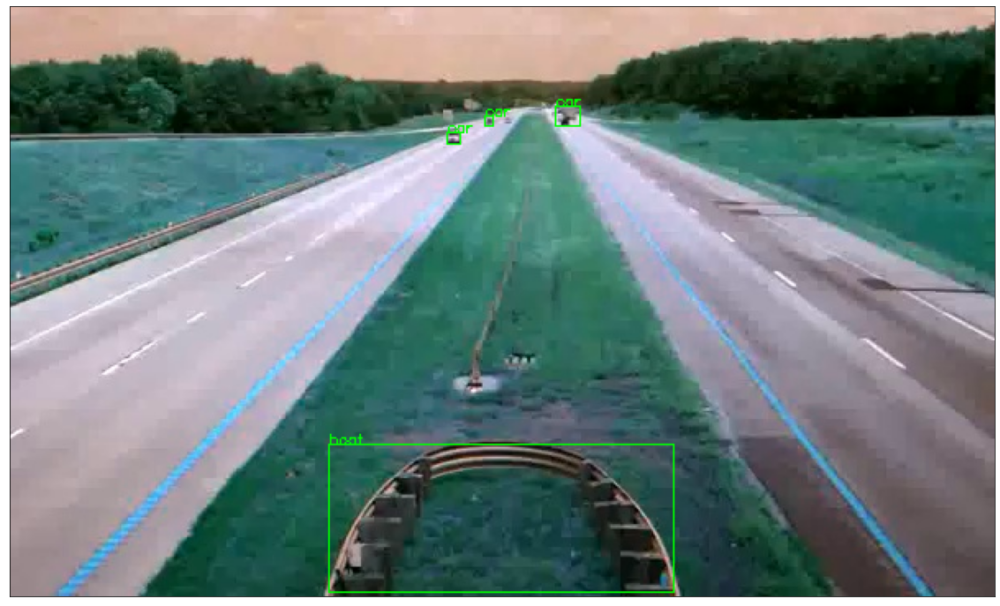

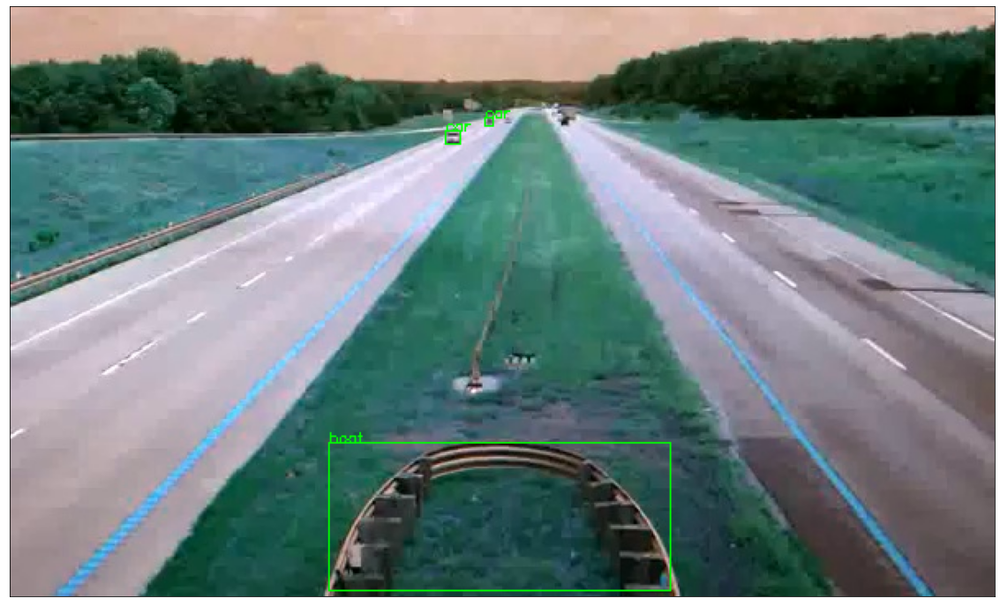

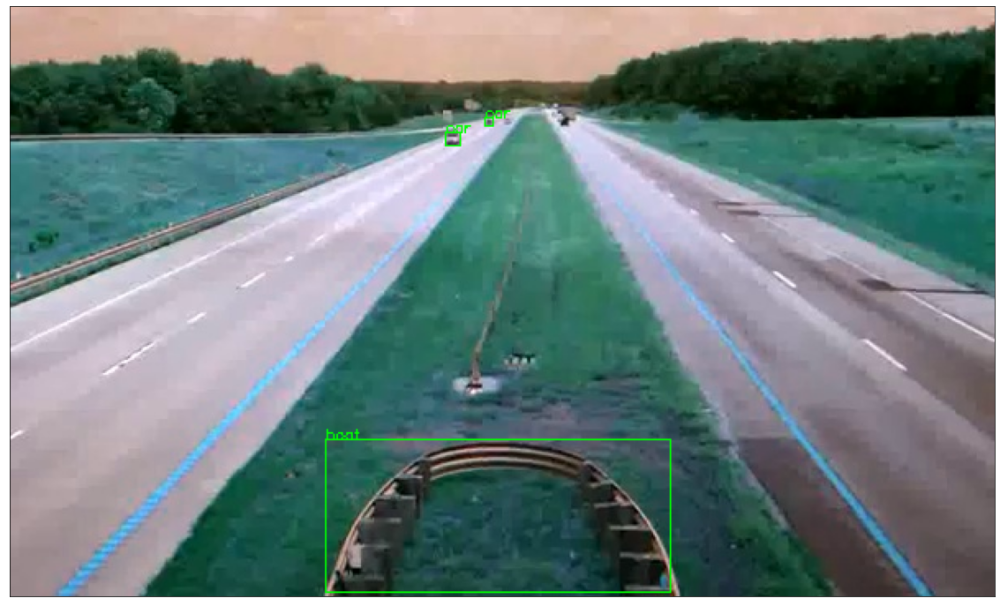

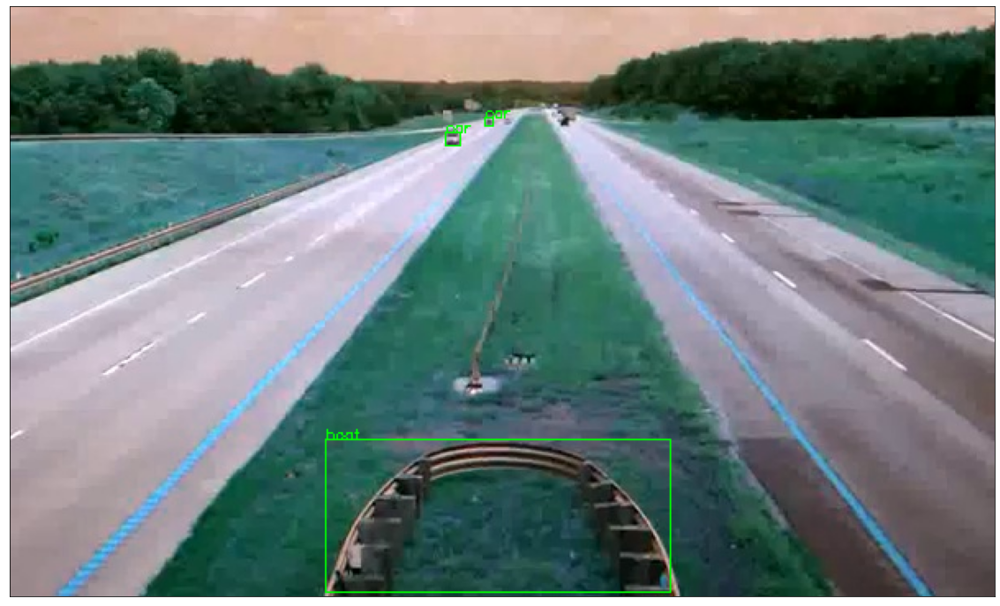

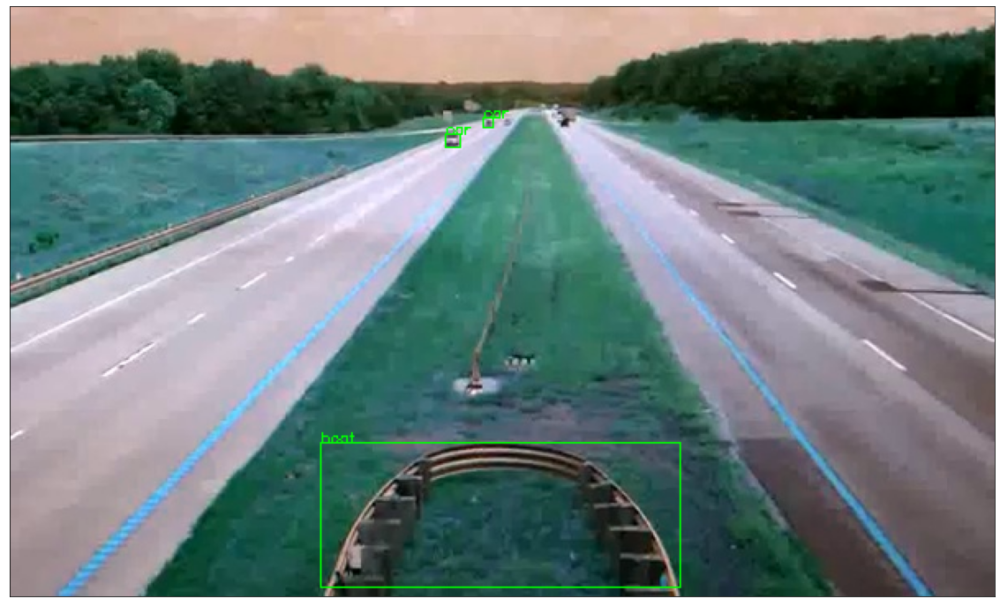

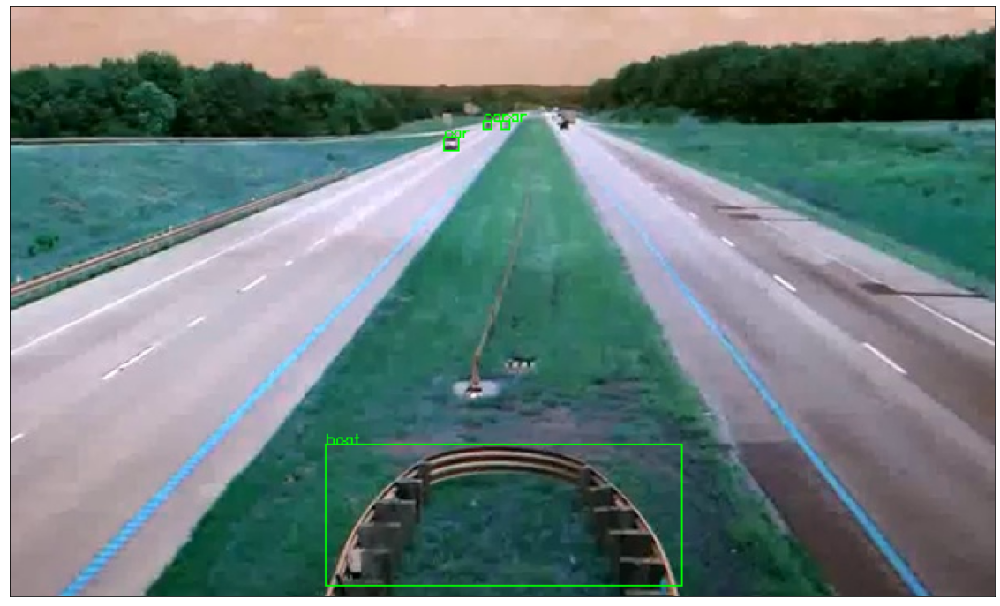

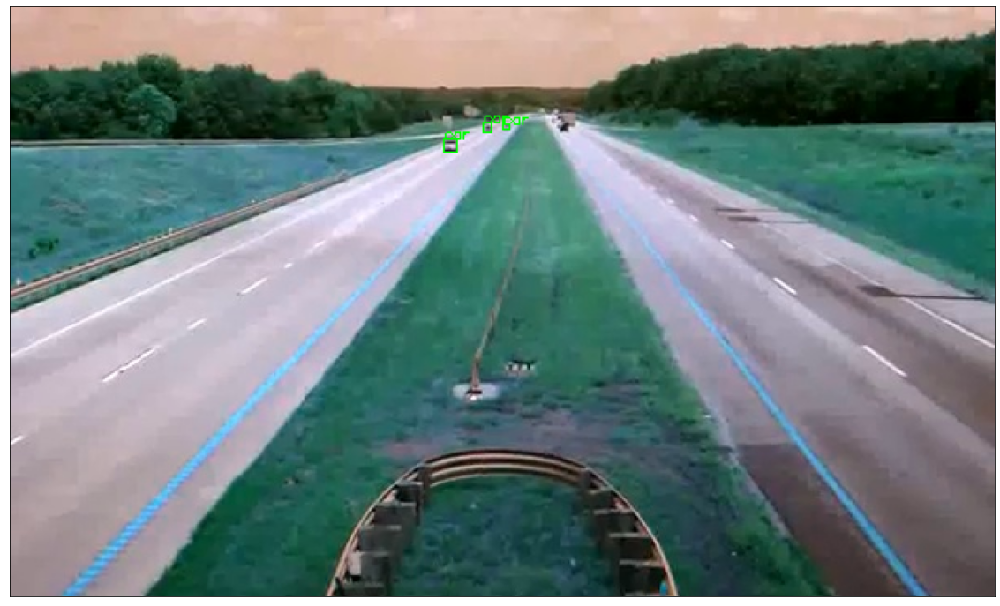

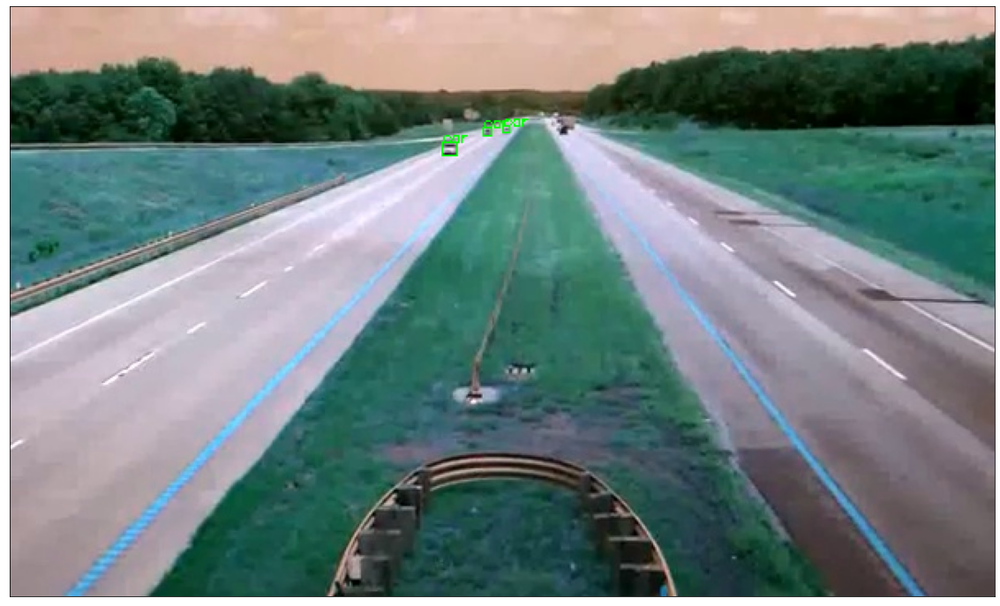

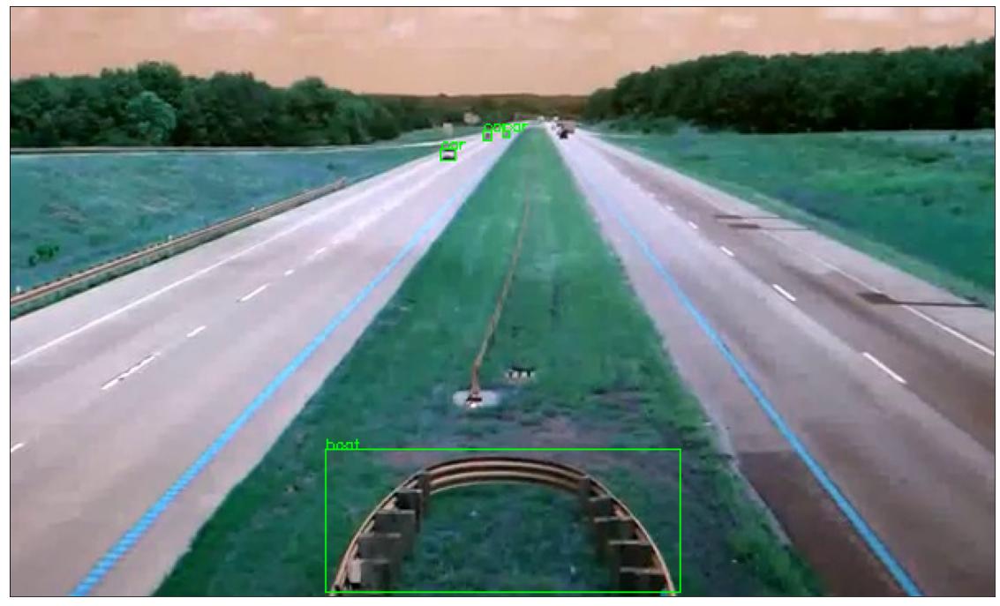

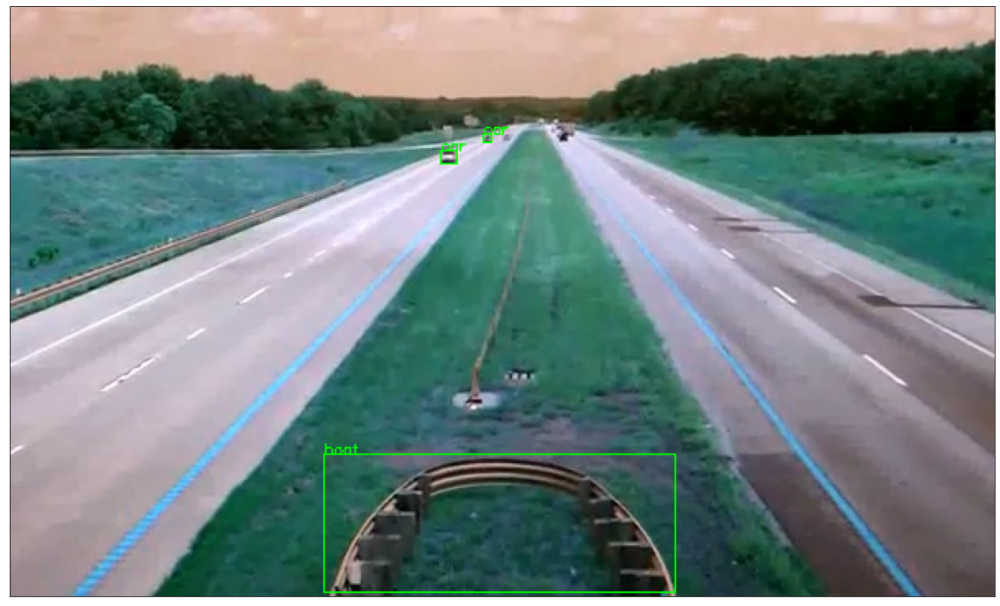

Frame number:  10


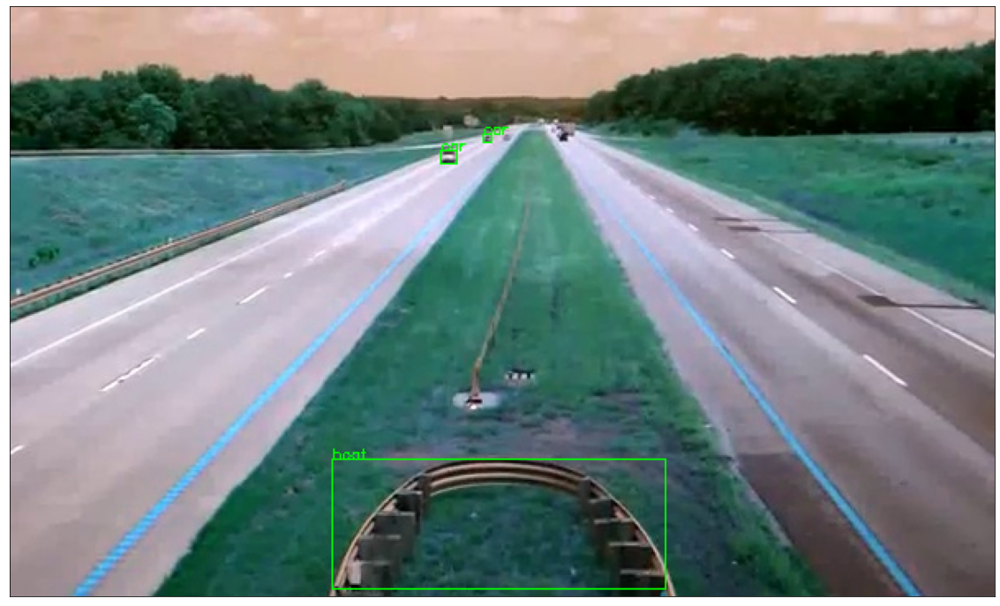

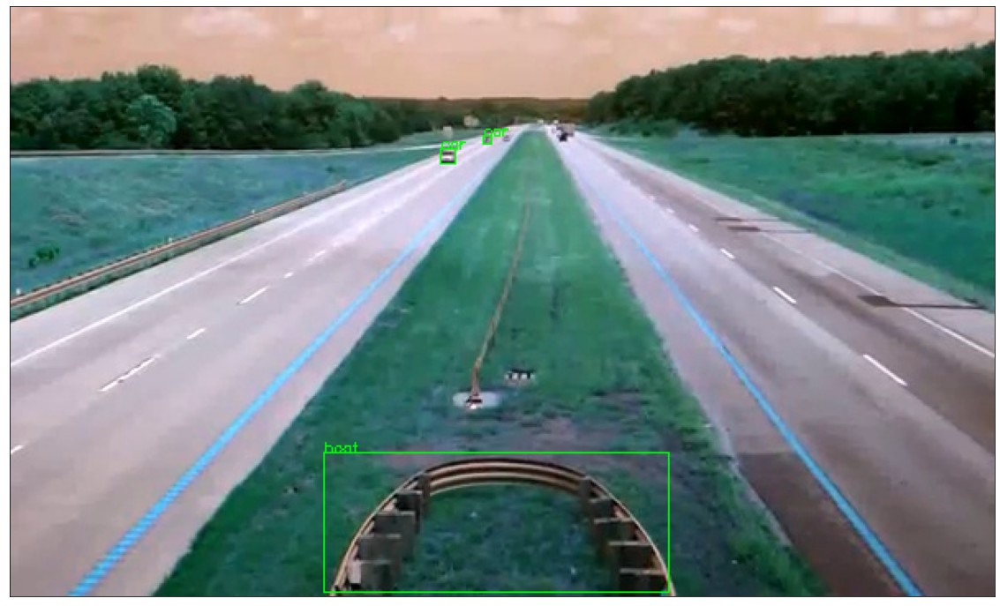

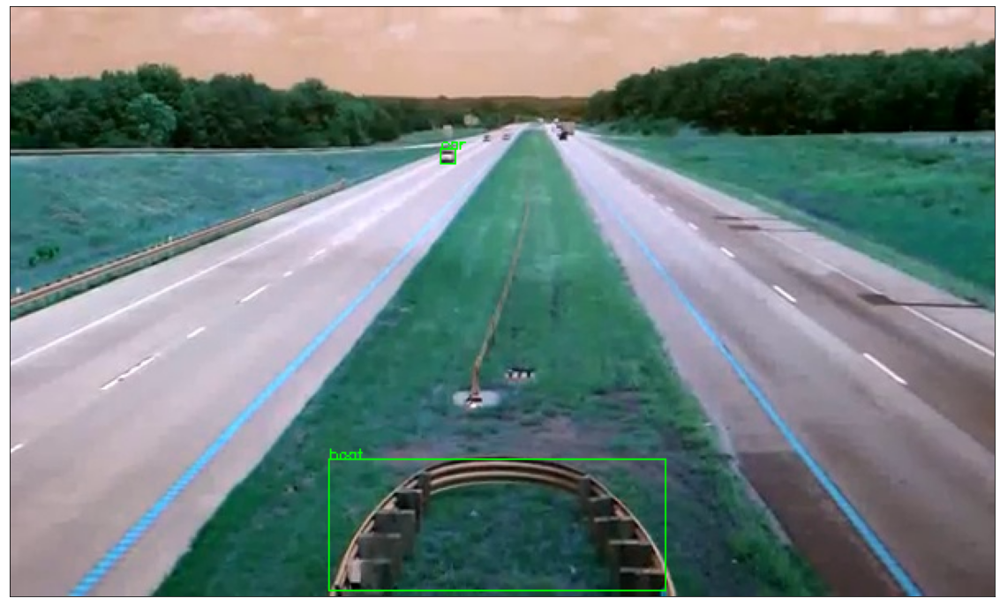

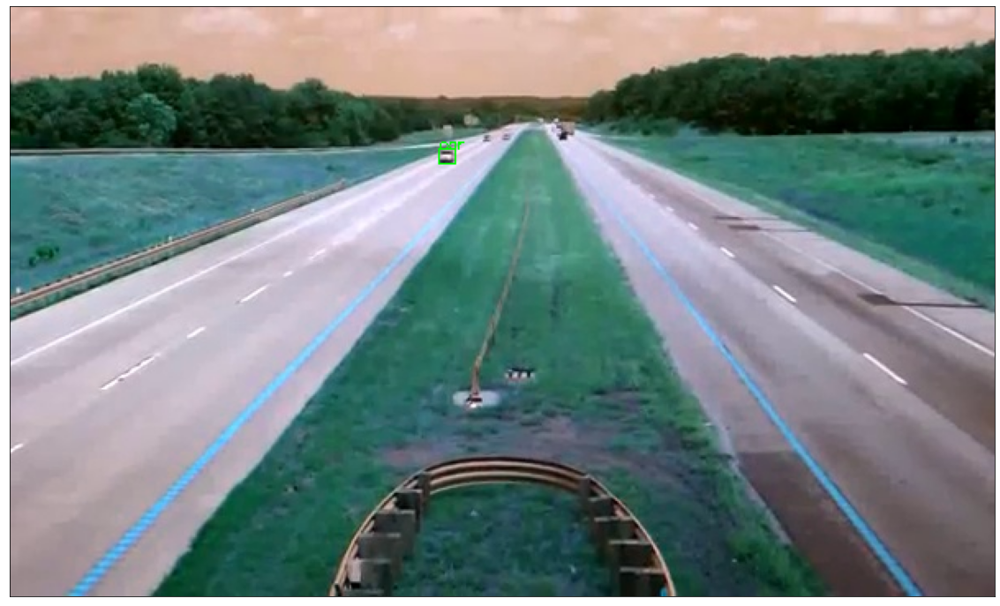

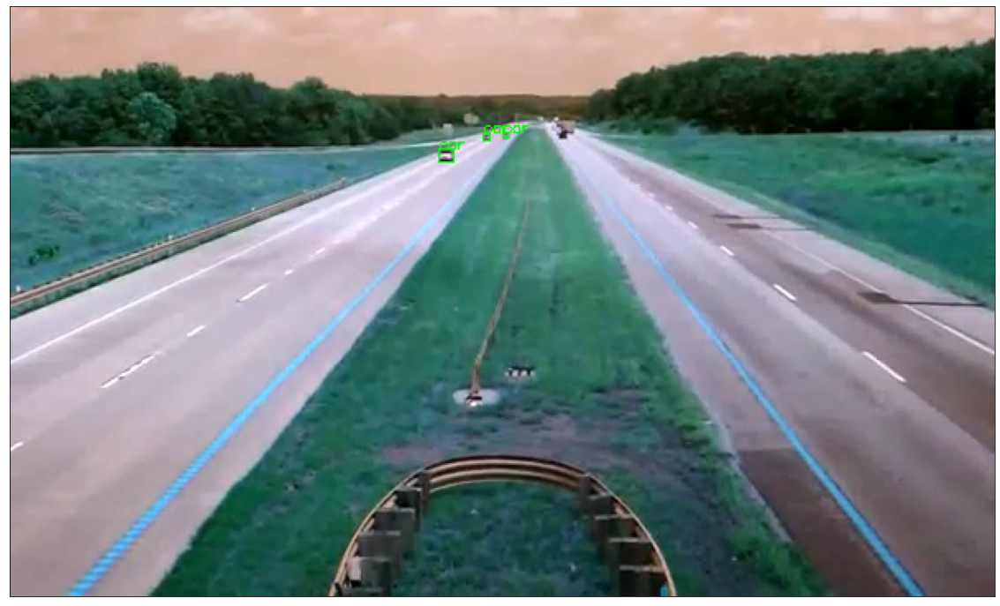

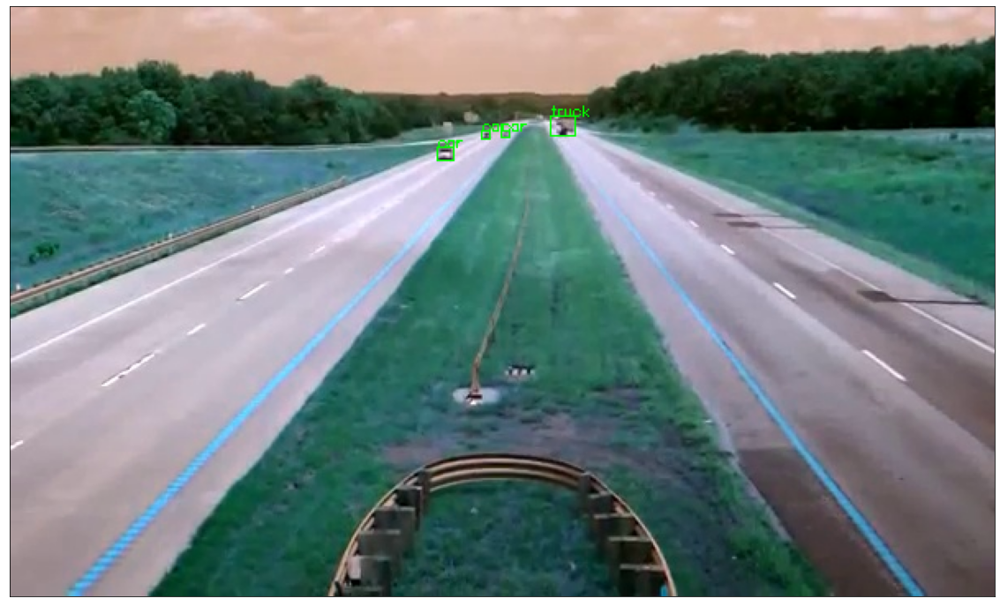

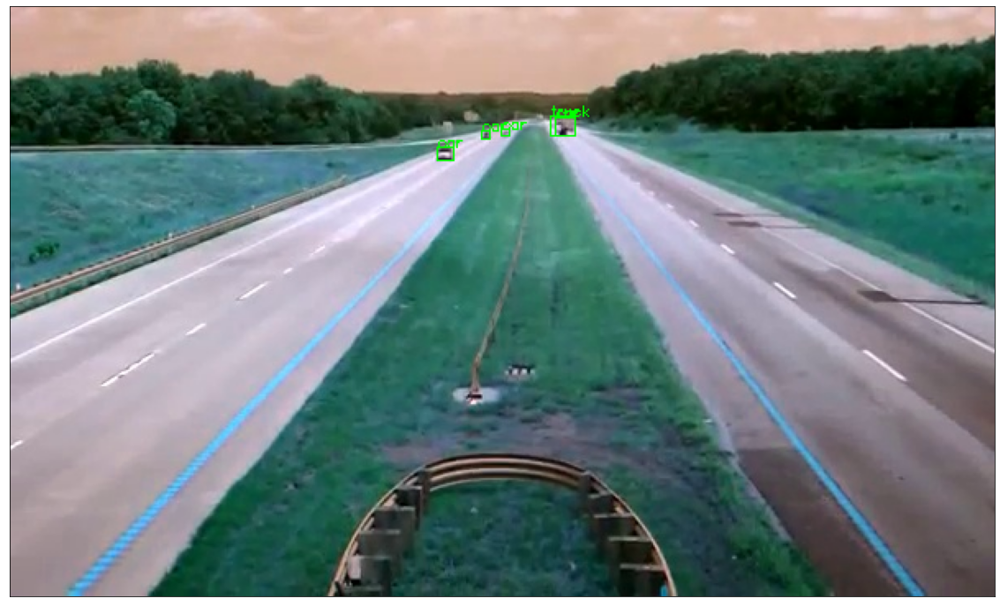

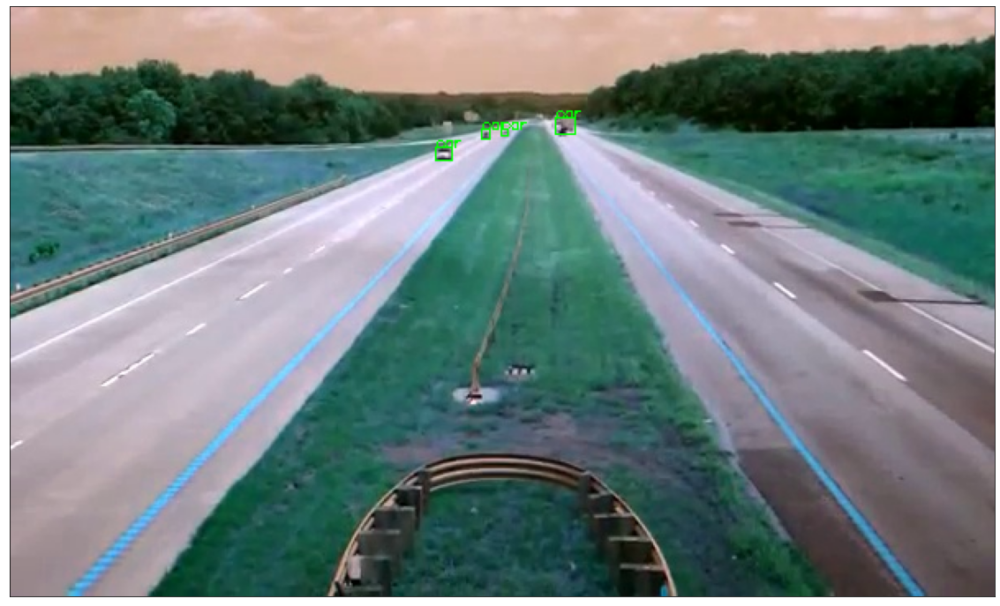

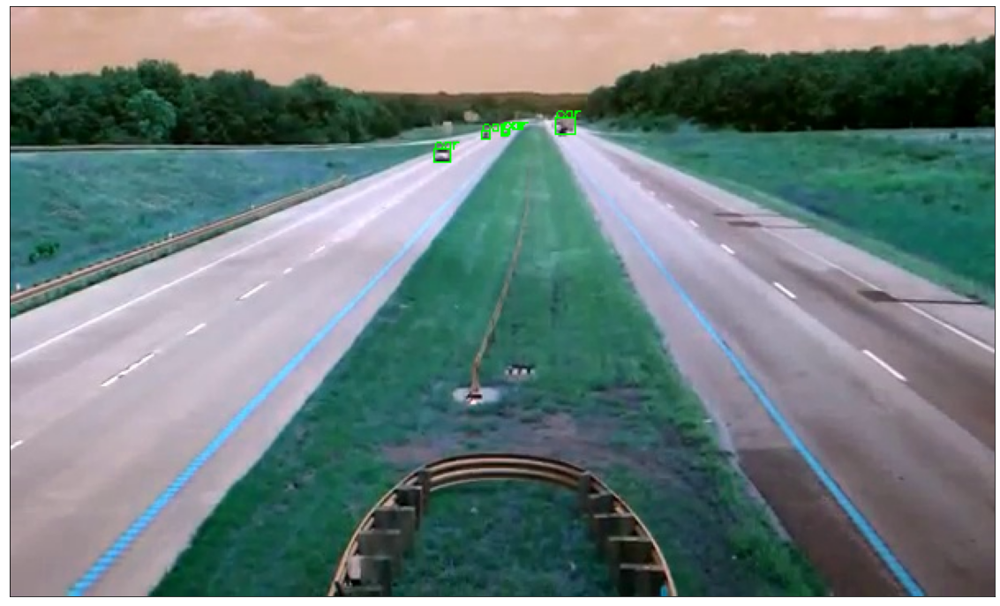

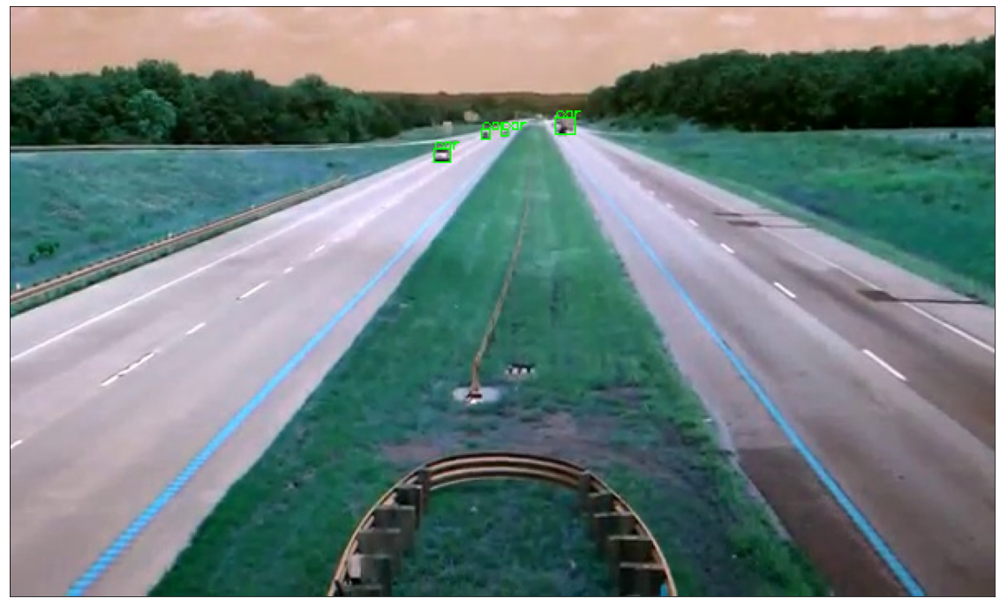

Frame number:  20


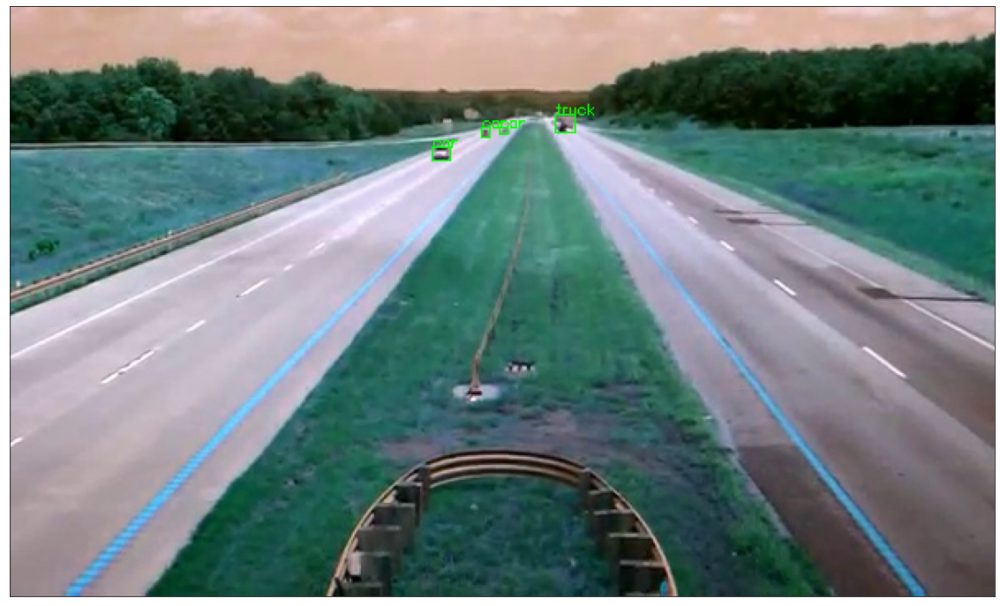

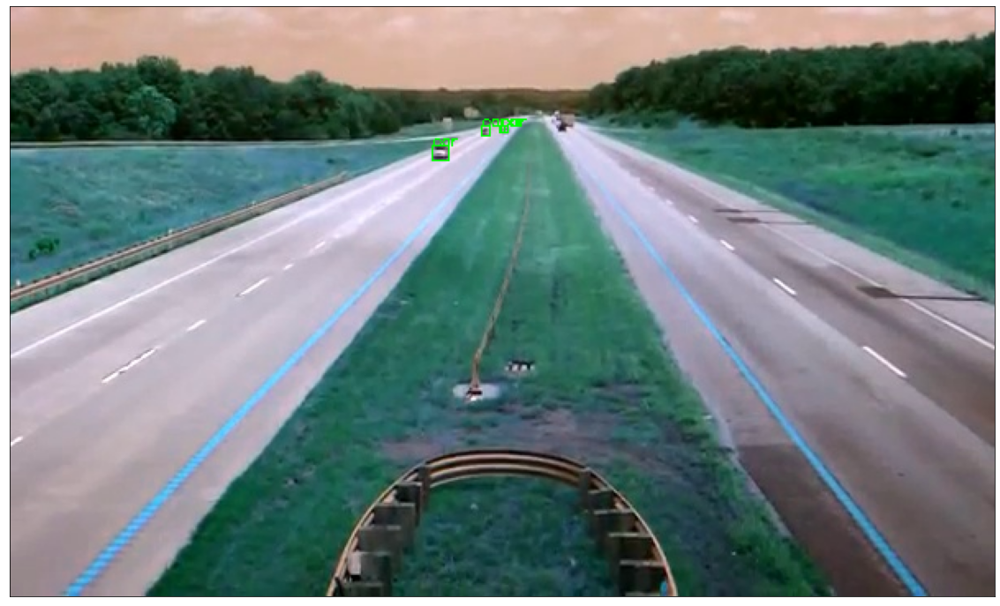

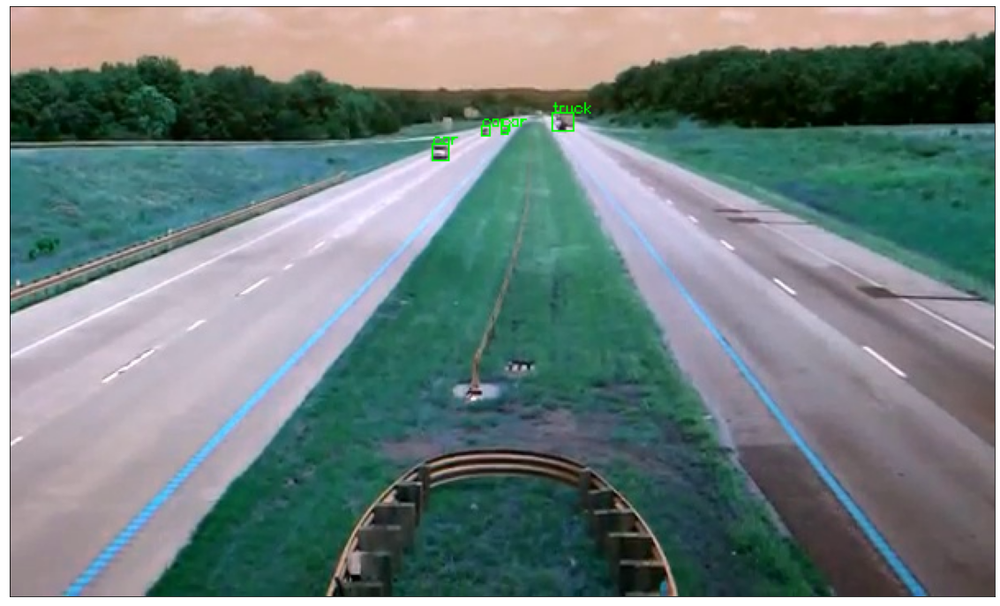

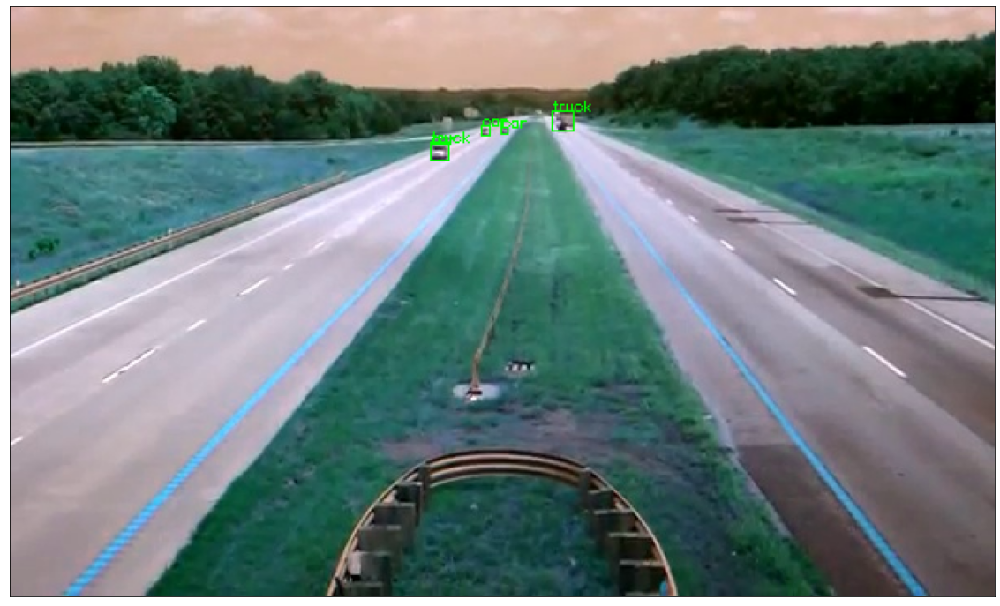

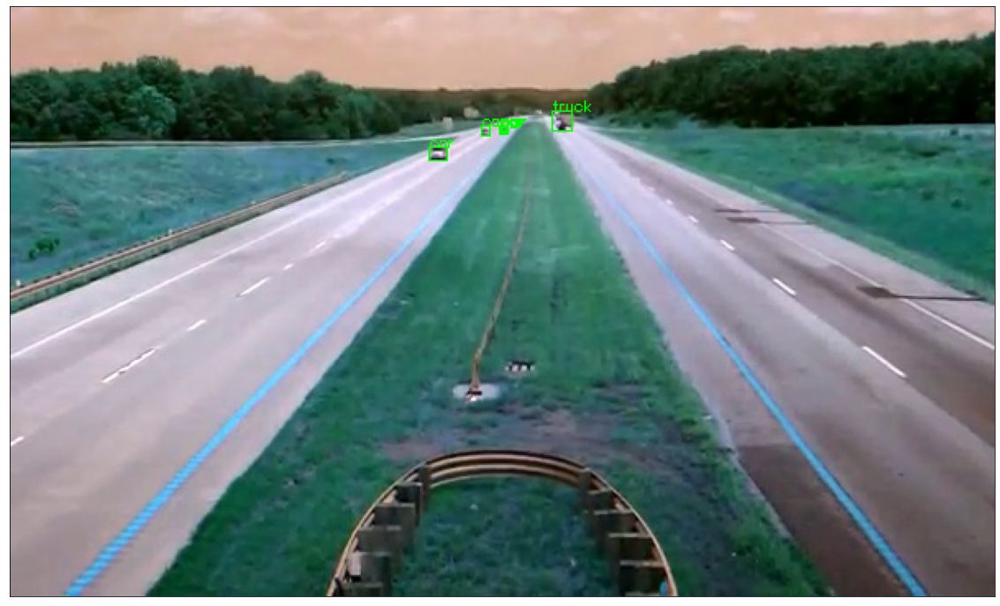

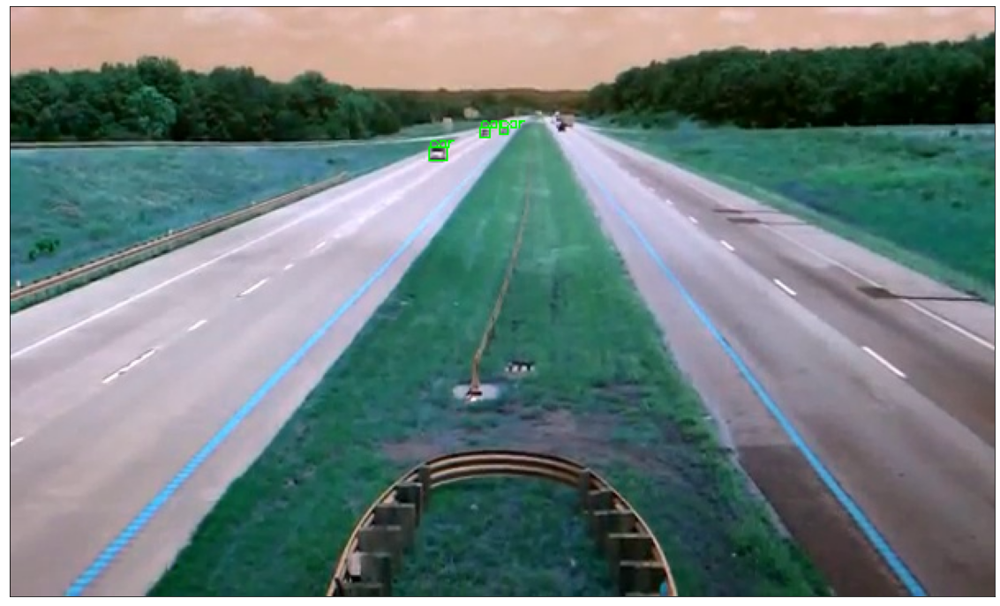

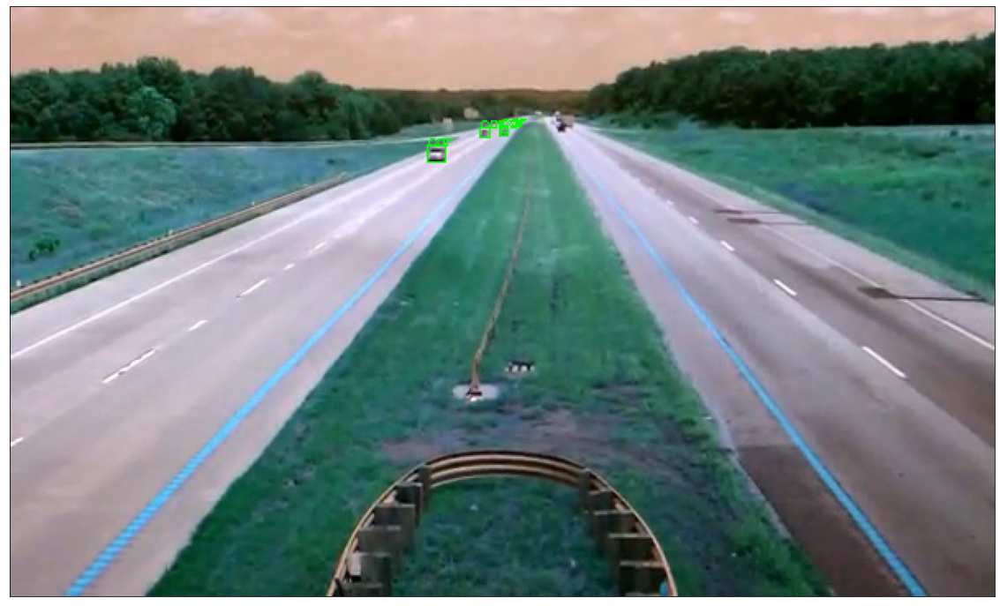

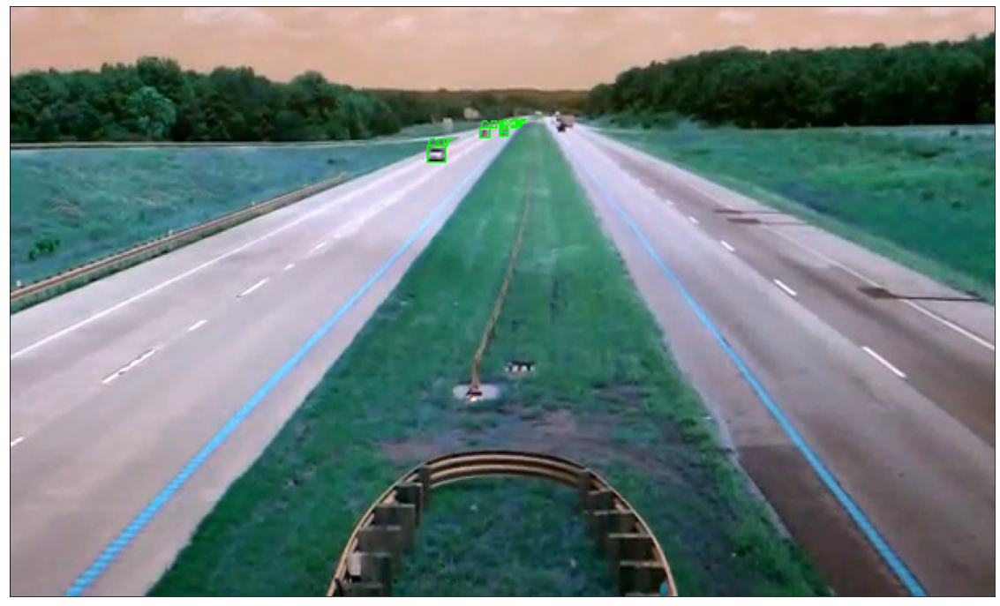

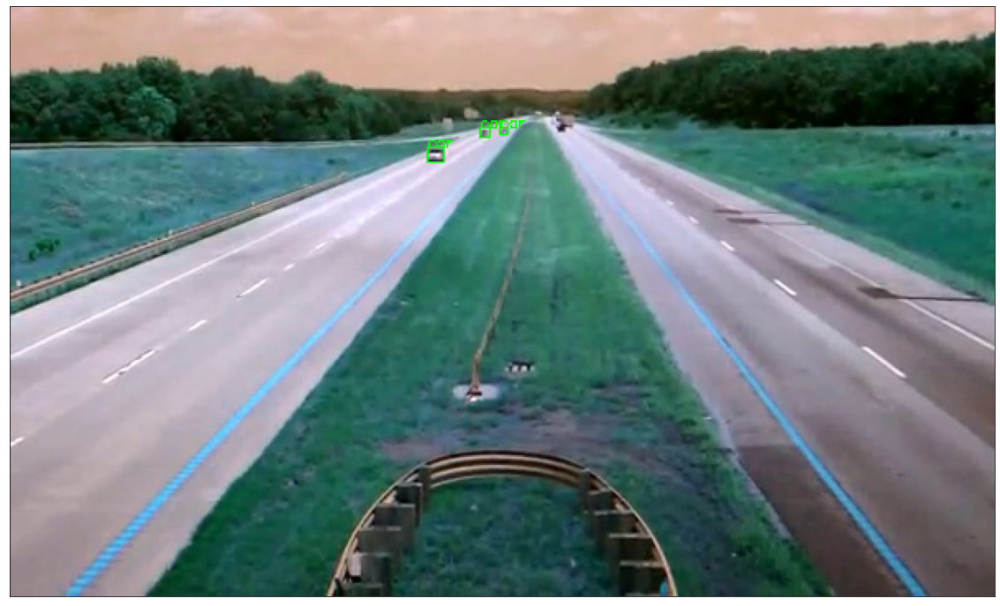

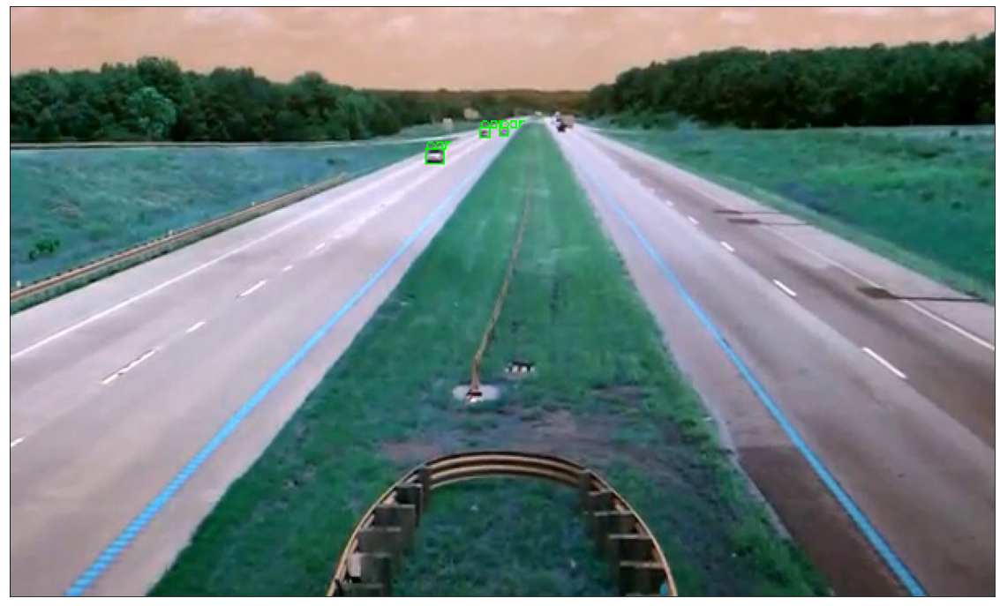

Frame number:  30


In [16]:
capture = cv2.VideoCapture('videoplayback.mp4')

width  = round(capture.get(cv2.CAP_PROP_FRAME_WIDTH))   
height = round(capture.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = round(capture.get(cv2.CAP_PROP_FPS))
fourcc = cv2.VideoWriter_fourcc(*'mp4v')

video_writer = cv2.VideoWriter('output_video.mp4',fourcc,fps,(width,height))

count = 0
max_count = 30
while capture.isOpened() and count < max_count:    
    ret, frame = capture.read()
    cv2.imwrite("frames/frame%d.jpg" % count, frame)
    object_detection_api("./frames/frame%d.jpg" % count, video_writer, rect_th=1, text_th=1, text_size=0.3)
    count += 1
    if count % 10 == 0: print('Frame number: ', count)
    
capture.release()
video_writer.release()

In [78]:
video_writer.release()

In [12]:
def get_vehicles_prediction(img, threshold):
    """
    get_prediction
    parameters:
      - img_path - path of the input image
      - threshold - threshold value for prediction score
    method:
      - Image is obtained from the image path
      - the image is converted to image tensor using PyTorch's Transforms
      - image is passed through the model to get the predictions
      - class, box coordinates are obtained, but only prediction score > threshold
        are chosen.
    """
    transform = T.Compose([T.ToTensor()])
    img = transform(img)
    pred = model([img])
    pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())]
    pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())]
    pred_score = list(pred[0]['scores'].detach().numpy())
    pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
    pred_boxes = pred_boxes[:pred_t+1]
    pred_class = pred_class[:pred_t+1]
    return pred_boxes, pred_class

'''
def vehicle_detection_api(input_img, threshold=0.5, rect_th=3, text_size=3, text_th=3):
    boxes, pred_cls = get_vehicles_prediction(input_img, threshold)
    # Get predictions
    img = input_img
    # Read image with cv2
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Convert to RGB
    for i in range(len(boxes)):
        cv2.rectangle(img, ftuple_to_ituple(boxes[i][0]), ftuple_to_ituple(boxes[i][1]),color=(0, 255, 0), thickness=rect_th)
        # Draw Rectangle with the coordinates
        cv2.putText(img, pred_cls[i], ftuple_to_ituple(boxes[i][0]), cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=text_th)
        # Write the prediction class
    plt.figure(figsize=(20,30))
    # display the output image
    plt.imshow(img) 
    plt.xticks([]) 
    plt.yticks([]) 
    plt.show()
'''

    
def vehicle_detection_api(input_img, video_writer, threshold=0.5, rect_th=3, text_size=3, text_th=3):
    boxes, pred_cls = get_vehicles_prediction(input_img, threshold)
    # Get predictions
    img = input_img
    # Read image with cv2
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Convert to RGB
    for i in range(len(boxes)):
        cv2.rectangle(img, ftuple_to_ituple(boxes[i][0]), ftuple_to_ituple(boxes[i][1]),color=(0, 255, 0), thickness=rect_th)
        # Draw Rectangle with the coordinates
        cv2.putText(img, pred_cls[i], ftuple_to_ituple(boxes[i][0]), cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=text_th)
        # Write the prediction class
    video_writer.write(img)
    plt.figure(figsize=(20,30))
    # display the output image
    plt.imshow(img) 
    plt.xticks([]) 
    plt.yticks([]) 
    plt.show()

In [13]:
capture = cv2.VideoCapture('videoplayback.mp4')
count = 0
max_count = 10
while capture.isOpened() and count < max_count:    
    ret, frame = capture.read()
    print('Frame number: ', count)
    vehicle_detection_api(frame, rect_th=1, text_th=1, text_size=0.3)
    count += 1

Frame number:  0


TypeError: vehicle_detection_api() missing 1 required positional argument: 'video_writer'

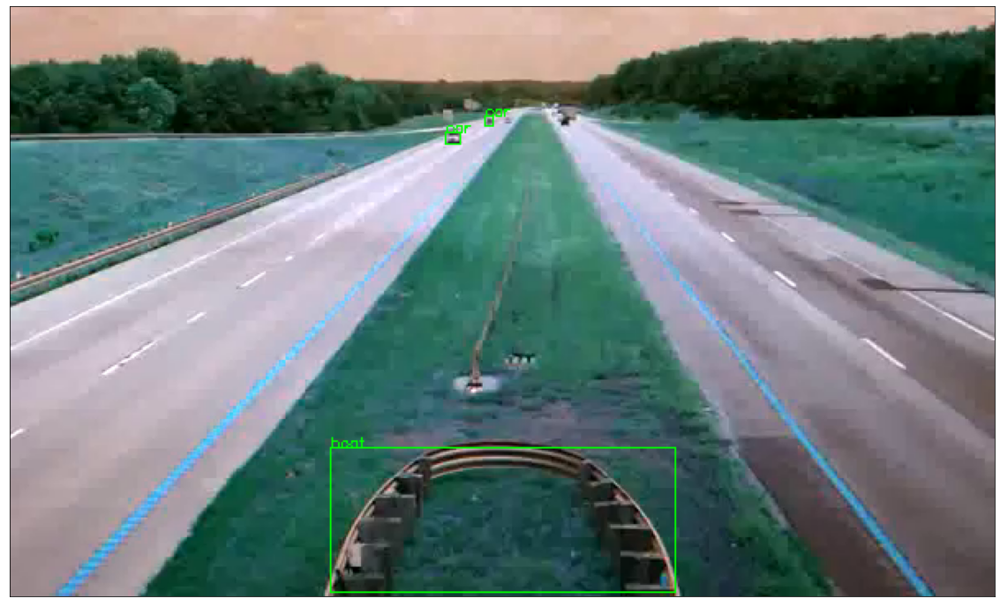

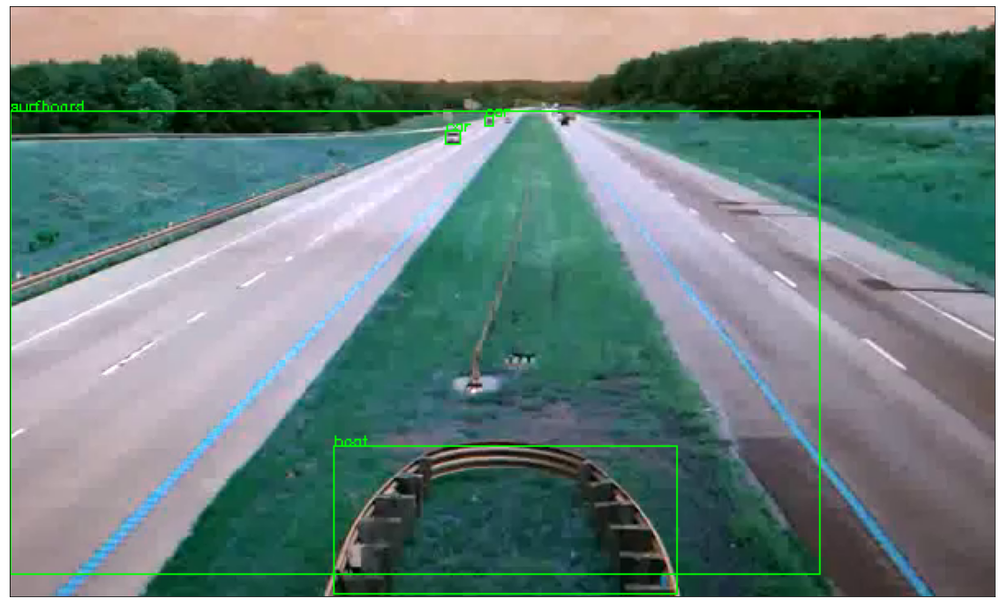

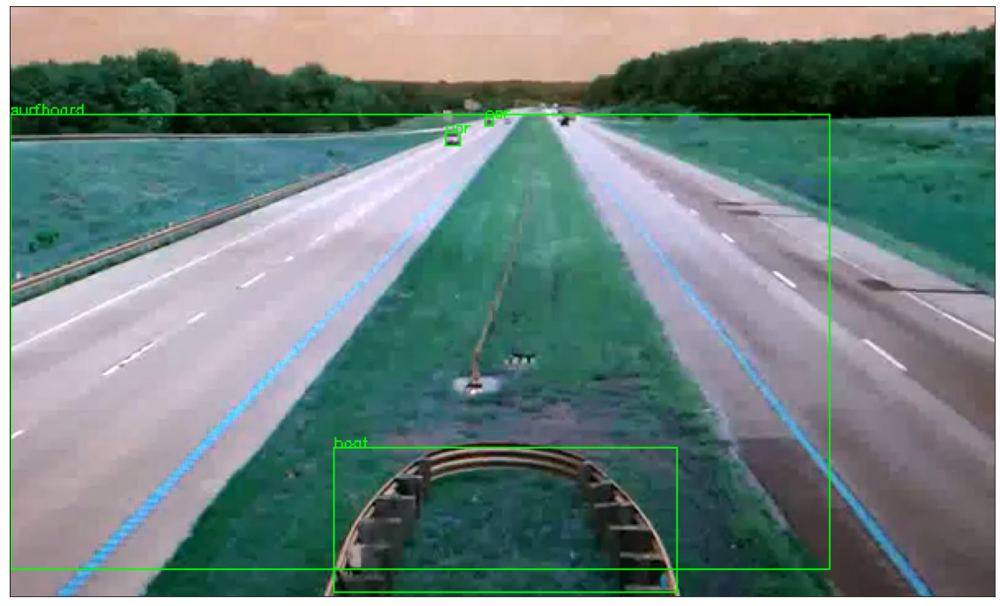

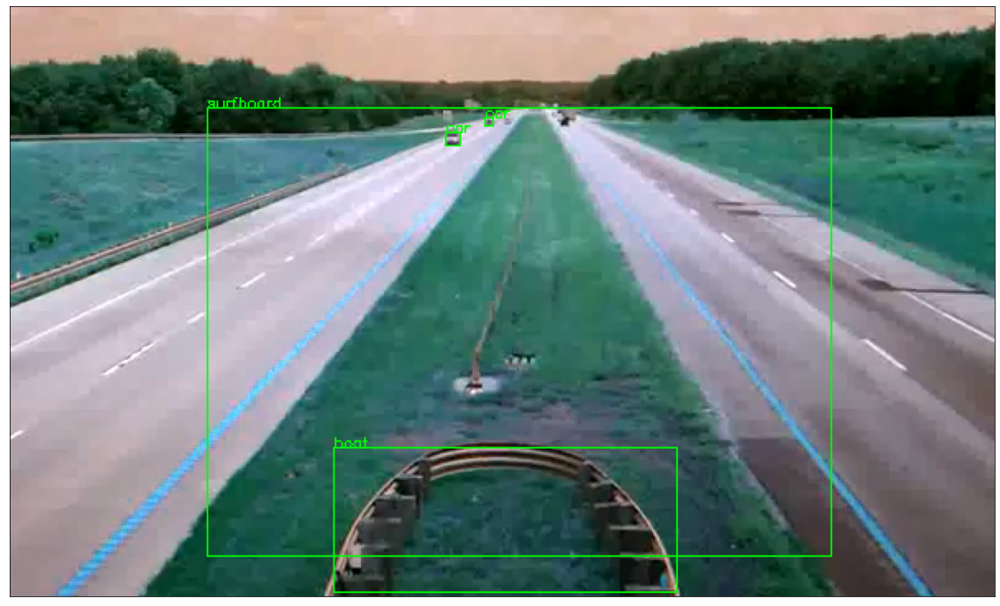

KeyboardInterrupt: 

In [14]:
capture = cv2.VideoCapture('videoplayback.mp4')

width  = round(capture.get(cv2.CAP_PROP_FRAME_WIDTH))   
height = round(capture.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = round(capture.get(cv2.CAP_PROP_FPS))
fourcc = cv2.VideoWriter_fourcc(*'mp4v')

video_writer = cv2.VideoWriter('output_video.mp4',fourcc,fps,(width,height))

count = 0
while capture.isOpened() and count < 30:    
    ret, frame = capture.read()
    vehicle_detection_api(frame, video_writer, threshold = 0.5, rect_th=1, text_th=1, text_size=0.3)
    count += 1

In [ ]:
COCO_INSTANCE_CATEGORY_NAMES = ['__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 
                                'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 
                                'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 
                                'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 
                                'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 
                                'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 
                                'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass', 
                                'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 
                                'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 
                                'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A', 
                                'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 
                                'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 
                                'N/A', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 
                                'toothbrush']

COCO_INSTANCE_CATEGORY_VEHICLES = ['car', 'bus', 'truck']

COCO_INSTANCE_CATEGORY_VEHICLES_INDEX = [3,6,8]

In [432]:
COCO_INSTANCE_CATEGORY_NAMES = ['__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 
                                'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 
                                'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 
                                'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 
                                'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 
                                'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 
                                'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass', 
                                'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 
                                'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 
                                'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A', 
                                'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 
                                'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 
                                'N/A', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 
                                'toothbrush']

COCO_INSTANCE_CATEGORY_VEHICLES = ['car', 'bus', 'truck']

COCO_INSTANCE_CATEGORY_VEHICLES_INDEX = [3,6,8]

In [187]:
def ftuple_to_ituple(tup):
    l = [int(i) for i in tup]
    return tuple(l)
        

def get_prediction(img_path, threshold):
    """
    get_prediction
    parameters:
      - img_path - path of the input image
      - threshold - threshold value for prediction score
    method:
      - Image is obtained from the image path
      - the image is converted to image tensor using PyTorch's Transforms
      - image is passed through the model to get the predictions
      - class, box coordinates are obtained, but only prediction score > threshold
        are chosen.
    """
    img = Image.open(img_path)
    transform = T.Compose([T.ToTensor()])
    img = transform(img)
    pred = model([img])
    mask = [x in COCO_INSTANCE_CATEGORY_VEHICLES_INDEX for x in list(pred[0]['labels'].numpy())]
    pred_class = np.array([COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())])
    pred_class = list(pred_class[mask])
    pred_boxes = list(np.array([[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())])[mask])
    pred_score = list(pred[0]['scores'].detach().numpy()[mask])
    pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
    pred_boxes = pred_boxes[:pred_t+1]
    pred_class = pred_class[:pred_t+1]
    unique, counts = np.unique(pred_class, return_counts=True)
    class_counts = dict(zip(unique, counts))
    if 'car' not in class_counts.keys(): class_counts['car'] = 0
    if 'truck' not in class_counts.keys(): class_counts['truck'] = 0
    total_cars = max(class_counts['car'],0)
    total_trucks = max(class_counts['truck'],0)
    return pred_boxes, pred_class, (total_cars, total_trucks)

def object_detection_api(img_path, video_writer, threshold=0.5, rect_th=3, text_size=3, text_th=3):
    boxes, pred_cls, total_score = get_prediction(img_path, threshold)
    # Get predictions
    img = cv2.imread(img_path)
    # Read image with cv2
    for i in range(len(boxes)):
        cv2.rectangle(img, ftuple_to_ituple(boxes[i][0]), ftuple_to_ituple(boxes[i][1]),color=(0, 255, 0), thickness=rect_th)
        # Draw Rectangle with the coordinates
        cv2.putText(img, pred_cls[i], ftuple_to_ituple(boxes[i][0]), cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=text_th)
        # Write the prediction class
    cv2.rectangle(img, (0,0), (100,72), color=(0, 255, 0), thickness = -1)
    cv2.putText(img, 'Cars = '+str(total_score[0]), (12,24), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,0,0),thickness=1)
    cv2.putText(img, 'Trucks = '+str(total_score[1]), (12,56), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,0,0),thickness=1)
    video_writer.write(img)

In [125]:
capture = cv2.VideoCapture('videoplayback.mp4')

width  = round(capture.get(cv2.CAP_PROP_FRAME_WIDTH))   
height = round(capture.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = round(capture.get(cv2.CAP_PROP_FPS))
fourcc = cv2.VideoWriter_fourcc(*'mp4v')

video_writer = cv2.VideoWriter('output_video.mp4',fourcc,fps,(width,height))

count = 0
max_count = 1801
while capture.isOpened() and count < max_count:    
    ret, frame = capture.read()
    cv2.imwrite("frames/frame%d.jpg" % count, frame)
    object_detection_api("./frames/frame%d.jpg" % count, video_writer, rect_th=1, text_th=1, 
                         text_size=0.3, threshold = 0.6)
    count += 1
    if count % 10 == 0: print('Frame number: ', count)
    
capture.release()
video_writer.release()

Frame number:  10
Frame number:  20
Frame number:  30
Frame number:  40
Frame number:  50
Frame number:  60
Frame number:  70
Frame number:  80
Frame number:  90
Frame number:  100
Frame number:  110
Frame number:  120
Frame number:  130
Frame number:  140
Frame number:  150
Frame number:  160
Frame number:  170
Frame number:  180
Frame number:  190
Frame number:  200
Frame number:  210
Frame number:  220
Frame number:  230
Frame number:  240
Frame number:  250
Frame number:  260
Frame number:  270
Frame number:  280
Frame number:  290
Frame number:  300
Frame number:  310
Frame number:  320
Frame number:  330
Frame number:  340
Frame number:  350
Frame number:  360
Frame number:  370
Frame number:  380
Frame number:  390
Frame number:  400
Frame number:  410
Frame number:  420
Frame number:  430
Frame number:  440
Frame number:  450
Frame number:  460
Frame number:  470
Frame number:  480
Frame number:  490
Frame number:  500
Frame number:  510
Frame number:  520
Frame number:  530
Fr

# Scoring

In [442]:
def get_prediction(img_path, threshold):
    """
    get_prediction
    parameters:
      - img_path - path of the input image
      - threshold - threshold value for prediction score
    method:
      - Image is obtained from the image path
      - the image is converted to image tensor using PyTorch's Transforms
      - image is passed through the model to get the predictions
      - class, box coordinates are obtained, but only prediction score > threshold
        are chosen.
    """
    img = Image.open(img_path)
    transform = T.Compose([T.ToTensor()])
    img = transform(img)
    pred = model([img])
    pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())]
    pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())]
    pred_score = list(pred[0]['scores'].detach().numpy())
    pred_t_list = [pred_score.index(x) for x in pred_score if x>threshold]
    if pred_t_list:
        pred_t = pred_t_list[-1]
        pred_boxes = pred_boxes[:pred_t+1]
        pred_class = pred_class[:pred_t+1]
        return pred_boxes, pred_class
    else:
        return [], []

In [189]:
json_filename = './GroundTruth/frame_10.jpg.json'
data = json.load(open(json_filename))
df = pd.DataFrame(data["instances"])

In [256]:
def compute_overlap(gth_box, pred_box, gth_class, pred_class, area_pcg):
    class_dict = {1:'car', 2:'truck', 3:'bus'}
    XA1 = gth_box['x1']
    XA2 = gth_box['x2']
    YA1 = gth_box['y1']
    YA2 = gth_box['y2']
    XB1, YB1 = pred_box[0]
    XB2, YB2 = pred_box[1]
    A_area = abs(XA1-XA2)*abs(YA1-YA2)
    B_area = abs(XB1-XB2)*abs(YB1-YB2)
    overlap_area = max(0, min(XA2, XB2) - max(XA1, XB1)) * max(0, min(YA2, YB2) - max(YA1, YB1))
    overlap_pcg = overlap_area/A_area
    if overlap_pcg > area_pcg and class_dict[gth_class]==pred_class: 
        return 'correct'
    elif overlap_pcg > area_pcg:
        return 'wrong_class'
    else: 
        return 'no'

In [422]:
#THIS WORKS

nframes = 10 #from 0 to 180 max
nn_threshold = 0.5
area_pcg = 0.5
scorelist = []

for i in tqdm(np.arange(nframes)*10):
    json_filename = './GroundTruth/frame_%d.jpg.json' % i
    data = json.load(open(json_filename))
    if len(data["tags"]) == 0:
        df = pd.DataFrame(data["instances"])
        bboxes = df.points
        gth_classes = df.classId
        frame_filename = './GroundTruth/frame_%d.jpg' % i
        pred_boxes, pred_classes = get_prediction(frame_filename, nn_threshold)
        score = 0
        for bbox, gth_classes in zip(bboxes,gth_classes):
            for pred_box, pred_class in zip(pred_boxes,pred_classes):
                score += compute_overlap(bbox, pred_box, gth_classes, pred_class, area_pcg)
        scorelist.append(score/len(bboxes))

  0%|          | 0/10 [00:00<?, ?it/s]/Users/ale/miniconda3/lib/python3.9/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ../c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
 30%|███       | 3/10 [00:08<00:20,  2.95s/it]


NameError: name 'COCO_INSTANCE_CATEGORY_VEHICLES_INDEX' is not defined

In [247]:
print(scorelist)

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


In [226]:
np.savetxt('scoring(0.5,0.5).csv', np.array(scorelist), delimiter=',')

# GRIDSEARCH

In [426]:
def boxes_to_dict(boxarray, classarray, framenum, nn_th, area_percentage):
    L = len(boxarray)
    mydict = {}
    for i in range(L):
        mydict[i] = {
            'x1' : 1*boxarray[i][0][0],
            'y1' : 1*boxarray[i][0][1],
            'x2' : 1*boxarray[i][1][0],
            'y2' : 1*boxarray[i][1][1],
            'classId' : classarray[i],
            'frame_number' : 1*float(framenum),
            'NN_threshold' : 1*nn_th,
            'Area_percentage' : 1*area_percentage
        }
    return mydict

In [ ]:
nframes = 181 #from 0 to 180 max
nn_thresholds = [0.5,0.6,0.7,0.8]
area_pcgs = [0.5,0.6,0.7,0.8]

for nn_threshold in tqdm(nn_thresholds):
    for area_pcg in area_pcgs:
        scorelist = []
        for i in np.arange(nframes)*10:
            json_filename = './GroundTruth/frame_%d.jpg.json' % i
            data = json.load(open(json_filename))
            if len(data["tags"]) == 0:
                df = pd.DataFrame(data["instances"])
                bboxes = df.points
                gth_classes = df.classId
                frame_filename = './GroundTruth/frame_%d.jpg' % i
                pred_boxes, pred_classes = get_prediction(frame_filename, nn_threshold)
                correct_score = 0
                almost_score = 0
                for bbox, gth_classes in zip(bboxes,gth_classes):
                    for pred_box, pred_class in zip(pred_boxes,pred_classes):
                        iscorrect = compute_overlap(bbox, pred_box, gth_classes, pred_class, area_pcg)
                        if iscorrect == 'correct': 
                            correct_score += 1
                        elif iscorrect == 'wrong_class': 
                            almost_score += 1
                
          

# Save predictions and load to DF

In [446]:
nframes = 181 #from 0 to 180 max
nn_thresholds = [0.5,0.6,0.7,0.8]
area_pcgs = [0.5,0.6,0.7,0.8]


for nn_threshold in nn_thresholds:
    for area_pcg in area_pcgs:
        for i in tqdm(np.arange(nframes)*10):
            if len(data["tags"]) == 0:
                frame_filename = './GroundTruth/frame_%d.jpg' % i
                pred_boxes, pred_classes = get_prediction(frame_filename, nn_threshold)
                mydict_pred = boxes_to_dict(pred_boxes, pred_classes, i, nn_threshold, area_pcg)
                with open('./Predictions2/frame_%d(n=%d,a=%d).json' % (i, 10*nn_threshold, 10*area_pcg), 'w') as fp:
                    json.dump(mydict_pred, fp)       
                


100%|██████████| 181/181 [21:37<00:00,  7.17s/it]


In [294]:
json_dict = json.dumps(dict_to_json_pred)  
with open('./Predictions/frame_50(n=5,a=5).json', 'w') as fp:
    json.dump(json_dict, fp)  

ciao


In [304]:
df = pd.read_json('./Predictions/frame_40(n=5,a=5).json').T
#df.frame_number = df.frame_number.astype(int)
df

,x1,y1,x2,y2,classId,frame_number,NN_threshold,Area_percentage
0,245.728806,91.898209,258.636993,102.761215,car,40.0,0.5,0.5
1,284.306091,78.470451,290.300476,84.641441,car,40.0,0.5,0.5
2,296.977356,77.898911,302.506287,83.101219,car,40.0,0.5,0.5
3,283.915436,75.498856,291.697998,85.348022,car,40.0,0.5,0.5


In [274]:
df

,x1,y1,x2,y2,classId,frame_number,NN_threshold,Area_percentage
0,182.880829,110.212311,208.643494,130.952713,car,90,0.5,0.5
1,450.925629,127.519409,488.560211,153.831238,car,90,0.5,0.5
2,273.878479,80.38308,281.402802,86.843163,car,90,0.5,0.5
3,289.259155,79.7351,296.962494,86.377388,car,90,0.5,0.5
4,330.346619,67.305122,339.223175,74.907181,car,90,0.5,0.5


# Load GT as DF

In [342]:
#Takes about 20s

nframes = 181
nn_thresholds = [0.5,0.6,0.7,0.8]
area_pcgs = [0.5,0.6,0.7,0.8]
columns = ['x1','y1','x2','y2','classId','frame_number']
PRED_df = pd.DataFrame(columns = columns)

for nn_threshold in nn_thresholds:
    for area_pcg in area_pcgs:
        for i in np.arange(nframes)*10:
            filename = './Predictions/frame_%d(n=%d,a=%d).json' % (i,10*nn_threshold,10*area_pcg)
            new_df = pd.read_json(filename).T
            PRED_df = PRED_df.append(new_df, ignore_index = True)
PRED_df.frame_number = PRED_df.frame_number.astype(int)

In [344]:
PRED_df['Recognized'] = False
PRED_df


,x1,y1,x2,y2,classId,frame_number,NN_threshold,Area_percentage,Recognized
0,266.257416,77.200035,274.85498,84.262711,car,0,0.5,0.5,False
1,289.19577,67.997673,294.557465,73.147499,car,0,0.5,0.5,False
2,262.7435,88.04834,272.156616,96.14402,car,10,0.5,0.5,False
3,288.435028,78.584961,293.58374,83.529137,car,10,0.5,0.5,False
4,258.082947,85.552414,267.617157,94.478081,car,20,0.5,0.5,False
...,...,...,...,...,...,...,...,...,...
12439,479.010559,220.491379,559.664673,276.907288,car,1790,0.8,0.8,False
12440,280.159943,97.949852,286.908478,104.031837,car,1790,0.8,0.8,False
12441,342.126587,100.526024,348.681396,104.850273,car,1790,0.8,0.8,False
12442,367.346069,105.537827,379.905884,114.506065,car,1790,0.8,0.8,False


# Load PRED as DF

In [13]:
nframes = 181
class_dict = {1:'car', 2:'truck', 3:'no_class', 4:'bus'}
columns = ['x1','y1','x2','y2','classId','frame_number']
GT_df = pd.DataFrame(columns = columns)

for i in np.arange(nframes)*10:
    filename = './GroundTruth/frame_%d.jpg.json' % i 
    data = json.load(open(filename))
    if len(data["tags"]) == 0:
        L = len(data["instances"])
        dicts = []
        for j in range(L):
            mydict = {
                'x1' : data["instances"][j]["points"]["x1"],
                'y1' : data["instances"][j]["points"]["y1"],
                'x2' : data["instances"][j]["points"]["x2"],
                'y2' : data["instances"][j]["points"]["y2"],
                'classId' : class_dict[data["instances"][j]["classId"]],
                'frame_number' : i
            }
            dicts.append(mydict)
        new_df = pd.DataFrame.from_dict(dicts)
        GT_df = GT_df.append(new_df, ignore_index = True)
GT_df

,x1,y1,x2,y2,classId,frame_number
0,249.141968,86.870743,266.399994,97.800003,car,30
1,236.600000,94.700000,253.000000,109.600000,car,50
2,228.000000,95.500000,247.600000,111.900000,car,60
3,213.924103,97.827415,236.600006,118.199997,car,70
4,541.058960,178.437210,600.000000,230.100006,car,70
...,...,...,...,...,...,...
346,403.317993,123.653854,426.000000,139.300003,truck,1730
347,393.926544,115.827660,415.100006,134.600006,truck,1740
348,387.665588,114.262421,404.100006,126.800003,truck,1750
349,382.200000,110.400000,395.500000,122.900000,truck,1760


In [143]:
GT_df['Recognized'] = False
GT_df['Area'] = abs(GT_df['x1']-GT_df['x2'])*abs(GT_df['y1']-GT_df['y2'])
GT_df[GT_df['classId'] == 'truck']

,x1,y1,x2,y2,classId,frame_number,Area,Recognized
99,258.533417,87.653366,273.399994,101.699997,truck,540,208.825321,False
102,254.600000,91.600000,268.700000,104.100000,truck,550,176.250000,False
104,249.100000,94.699997,264.000000,107.200000,truck,560,186.250045,False
106,244.400000,95.500000,259.300000,109.600000,truck,570,210.090000,False
109,235.000000,97.800000,252.300000,115.100000,truck,580,299.290000,False
...,...,...,...,...,...,...,...,...
345,417.405121,128.349564,444.000000,149.500000,truck,1720,562.493300,False
346,403.317993,123.653854,426.000000,139.300003,truck,1730,354.886051,False
347,393.926544,115.827660,415.100006,134.600006,truck,1740,397.475564,False
348,387.665588,114.262421,404.100006,126.800003,truck,1750,206.047866,False


<AxesSubplot:>

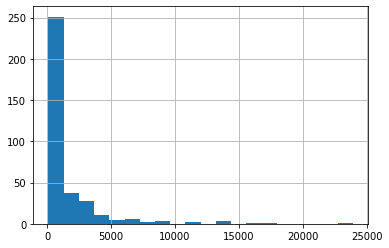

In [5]:
GT_df['Area'].hist(bins=20)

In [ ]:
def scoring(whole_gth_df, pred_df):    #total GT df and grouped PRED df
    area_pcg = pred_df['Area_percentage']
    frame = int(pred_df['frame_number'])
    gth_df = whole_gth_df[whole_gth_df['frame_number']==frame]
    XA1 = gth_df['x1']
    XA2 = gth_df['x2']
    YA1 = gth_df['y1']
    YA2 = gth_df['y2']
    XB1 = pred_df['x1']
    XB2 = pred_df['x2']
    YB1 = pred_df['y1']
    YB2 = pred_df['y2']
    A_area = abs(XA1-XA2)*abs(YA1-YA2)
    B_area = abs(XB1-XB2)*abs(YB1-YB2)
    overlap_area = max(0, min(XA2, XB2) - max(XA1, XB1)) * max(0, min(YA2, YB2) - max(YA1, YB1))
    overlap_pcg = overlap_area/A_area
    if overlap_pcg > area_pcg and class_dict[gth_class]==pred_class: 
        return 'correct'
    elif overlap_pcg > area_pcg:
        return 'wrong_class'
    else: 
        return 'no'

In [345]:
def compute_overlap(A, B, classif = False):    #total GT df and grouped PRED df
    a_idx = A.index
    b_idx = B.index
    a_class = str(A.loc[a_idx,'classId'])
    print(type(a_class))
    b_class = B.loc[b_idx,'classId']
    area_pcg = float(B['Area_percentage'])
    XA1 = float(A['x1'])
    XA2 = float(A['x2'])
    YA1 = float(A['y1'])
    YA2 = float(A['y2'])
    XB1 = float(B['x1'])
    XB2 = float(B['x2'])
    YB1 = float(B['y1'])
    YB2 = float(B['y2'])
    A_area = abs(XA1-XA2)*abs(YA1-YA2)
    B_area = abs(XB1-XB2)*abs(YB1-YB2)
    overlap_area = max(0, min(XA2, XB2) - max(XA1, XB1)) * max(0, min(YA2, YB2) - max(YA1, YB1))
    IoU = overlap_area/(A_area + B_area - overlap_area)
    if IoU >= area_pcg:
        if classif:
            if a_class.equals(b_class):
                B.loc[b_idx,'Recognized'] = True
        else:
            B.loc[b_idx,'Recognized'] = True
                
       


In [ ]:
for j in range(len(PRED_df)):
    test_B = PRED_df.loc[j]
    x = []
    for i in range(len(GT_df)):
        test_A = GT_df.loc[i]
        x.append(compute_overlap(test_A, test_B))
    print(sum(x))

In [290]:
def scoring_grouped_df(whole_gt_df, grouped_pred_df, classif = False):
    frame = int(grouped_pred_df['frame_number'])
    gt_df = whole_gt_df[whole_gt_df['frame_number']==frame]
    for i in gt_df.index:
        test_A = gt_df[gt_df.index == i]
        compute_overlap(test_A, grouped_pred_df, classif)
    return grouped_pred_df
        
    

In [282]:
%%time
PRED_df = PRED_df.groupby(PRED_df.index).apply(lambda row : scoring_grouped_df(GT_df, row))


CPU times: user 24.3 s, sys: 298 ms, total: 24.6 s
Wall time: 24.5 s


In [283]:
PRED_df.Recognized.sum()

4136

In [284]:
Recall = PRED_df.groupby(['NN_threshold','Area_percentage']).apply(lambda x : sum(x.Recognized)/len(GT_df)).to_frame()
Recall = Recall.reset_index().pivot(columns='NN_threshold',index='Area_percentage',values=0)
Recall.columns = pd.Series([0.5,0.6,0.7,0.8], name = 'NN_threshold')
Recall.index = pd.Series([0.5,0.6,0.7,0.8], name = 'Area_percentage')
Recall

NN_threshold,0.5,0.6,0.7,0.8
Area_percentage,,,,
0.5,0.957265,0.943020,0.905983,0.851852
0.6,0.883191,0.868946,0.840456,0.800570
0.7,0.729345,0.715100,0.692308,0.666667
0.8,0.498575,0.490028,0.478632,0.461538


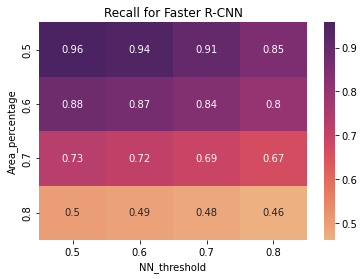

In [285]:
cmap = sns.color_palette("flare", as_cmap=True)

ax = plt.axes()
sns.heatmap(Recall, annot=True, cmap=cmap, ax=ax)
ax.set_title('Recall for Faster R-CNN')
plt.show()

In [286]:
Precision = PRED_df.groupby(['NN_threshold','Area_percentage']).apply(lambda x : sum(x.Recognized)/len(x)).to_frame()
Precision = Precision.reset_index().pivot(columns='NN_threshold',index='Area_percentage',values=0)
Precision.columns = pd.Series([0.5,0.6,0.7,0.8], name = 'NN_threshold')
Precision.index = pd.Series([0.5,0.6,0.7,0.8], name = 'Area_percentage')
Precision


NN_threshold,0.5,0.6,0.7,0.8
Area_percentage,,,,
0.5,0.348910,0.396407,0.441054,0.505068
0.6,0.321911,0.365269,0.409154,0.474662
0.7,0.265836,0.300599,0.337032,0.395270
0.8,0.181724,0.205988,0.233010,0.273649


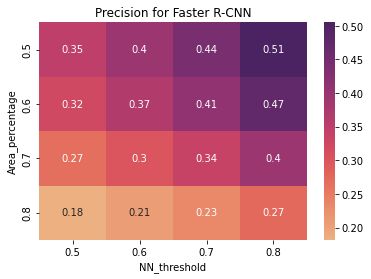

In [287]:
cmap = sns.color_palette("flare", as_cmap=True)

ax = plt.axes()
sns.heatmap(Precision, annot=True, cmap=cmap, ax=ax)
ax.set_title('Precision for Faster R-CNN')
plt.show()

In [200]:
L = len(GT_df)
nn_threshold = pd.Series([0.5]*L + [0.6]*L + [0.7]*L + [0.8]*L, name = 'NN_threshold')
area_percentage =  pd.Series([0.5,0.6,0.7,0.8]*L, name = 'Area_percentage')

Combined_DF_df = GT_df

In [191]:
Combined_DF_df = Combined_DF_df.append(GT_df,ignore_index = True)
Combined_DF_df = Combined_DF_df.append(GT_df,ignore_index = True)
Combined_DF_df = Combined_DF_df.append(GT_df,ignore_index = True)

Combined_DF_df['NN_threshold'] = nn_threshold
Combined_DF_df['Area_percentage'] = area_percentage

In [192]:
Combined_DF_df

,x1,y1,x2,y2,classId,frame_number,Area,Recognized,NN_threshold,Area_percentage
0,249.141968,86.870743,266.399994,97.800003,car,30,188.617459,False,0.5,0.5
1,236.600000,94.700000,253.000000,109.600000,car,50,244.360000,False,0.5,0.6
2,228.000000,95.500000,247.600000,111.900000,car,60,321.440000,False,0.5,0.7
3,213.924103,97.827415,236.600006,118.199997,car,70,461.966688,False,0.5,0.8
4,541.058960,178.437210,600.000000,230.100006,car,70,3045.058929,False,0.5,0.5
...,...,...,...,...,...,...,...,...,...,...
1399,403.317993,123.653854,426.000000,139.300003,truck,1730,354.886051,False,0.8,0.8
1400,393.926544,115.827660,415.100006,134.600006,truck,1740,397.475564,False,0.8,0.5
1401,387.665588,114.262421,404.100006,126.800003,truck,1750,206.047866,False,0.8,0.6
1402,382.200000,110.400000,395.500000,122.900000,truck,1760,166.250000,False,0.8,0.7


In [177]:
Area_percentage

[0.5, 0.6, 0.7, 0.8, 0.5, 0.6, 0.7, 0.8, 0.5, 0.6, 0.7, 0.8]

In [ ]:
def scoring_grouped_df(whole_gt_df, grouped_pred_df):
    frame = int(grouped_pred_df['frame_number'])
    gt_df = whole_gt_df[whole_gt_df['frame_number']==frame]
    for i in gt_df.index:
        test_A = gt_df[gt_df.index == i]
        compute_overlap(test_A, grouped_pred_df)
    return grouped_pred_df

In [341]:
PRED_df['Recognized'] = False
PRED_df['classId'] = PRED_df['classId'].astype('str') 
GT_df['classId'] = GT_df['classId'].astype('str') 
PRED_df

,x1,y1,x2,y2,classId,frame_number,NN_threshold,Area_percentage,Recognized
0,266.257416,77.200035,274.85498,84.262711,0 car\n1 car\n2 car\n3 ...,0,0.5,0.5,False
1,289.19577,67.997673,294.557465,73.147499,0 car\n1 car\n2 car\n3 ...,0,0.5,0.5,False
2,262.7435,88.04834,272.156616,96.14402,0 car\n1 car\n2 car\n3 ...,10,0.5,0.5,False
3,288.435028,78.584961,293.58374,83.529137,0 car\n1 car\n2 car\n3 ...,10,0.5,0.5,False
4,258.082947,85.552414,267.617157,94.478081,0 car\n1 car\n2 car\n3 ...,20,0.5,0.5,False
...,...,...,...,...,...,...,...,...,...
12439,479.010559,220.491379,559.664673,276.907288,0 car\n1 car\n2 car\n3 ...,1790,0.8,0.8,False
12440,280.159943,97.949852,286.908478,104.031837,0 car\n1 car\n2 car\n3 ...,1790,0.8,0.8,False
12441,342.126587,100.526024,348.681396,104.850273,0 car\n1 car\n2 car\n3 ...,1790,0.8,0.8,False
12442,367.346069,105.537827,379.905884,114.506065,0 car\n1 car\n2 car\n3 ...,1790,0.8,0.8,False


In [372]:
def compute_overlap(A, B, classif = False):    #total GT df and grouped PRED df
    a_idx = A.index
    b_idx = B.index
    a_class = A.loc[a_idx,'classId'].values[0].strip()
    b_class = B.loc[b_idx,'classId'].values[0].strip()
    area_pcg = float(B['Area_percentage'])
    XA1 = float(A['x1'])
    XA2 = float(A['x2'])
    YA1 = float(A['y1'])
    YA2 = float(A['y2'])
    XB1 = float(B['x1'])
    XB2 = float(B['x2'])
    YB1 = float(B['y1'])
    YB2 = float(B['y2'])
    A_area = abs(XA1-XA2)*abs(YA1-YA2)
    B_area = abs(XB1-XB2)*abs(YB1-YB2)
    overlap_area = max(0, min(XA2, XB2) - max(XA1, XB1)) * max(0, min(YA2, YB2) - max(YA1, YB1))
    IoU = overlap_area/(A_area + B_area - overlap_area)
    if IoU >= area_pcg:
        if classif:
            if a_class==b_class:
                B.loc[b_idx,'Recognized'] = True
        else:
            B.loc[b_idx,'Recognized'] = True
                
       



In [373]:
%%time
PRED_df = PRED_df.groupby(PRED_df.index).apply(lambda row : scoring_grouped_df(GT_df, row, classif=True))



CPU times: user 35 s, sys: 430 ms, total: 35.5 s
Wall time: 35.3 s


In [374]:
PRED_df

,x1,y1,x2,y2,classId,frame_number,NN_threshold,Area_percentage,Recognized
0,266.257416,77.200035,274.85498,84.262711,car,0,0.5,0.5,False
1,289.19577,67.997673,294.557465,73.147499,car,0,0.5,0.5,False
2,262.7435,88.04834,272.156616,96.14402,car,10,0.5,0.5,False
3,288.435028,78.584961,293.58374,83.529137,car,10,0.5,0.5,False
4,258.082947,85.552414,267.617157,94.478081,car,20,0.5,0.5,False
...,...,...,...,...,...,...,...,...,...
12439,479.010559,220.491379,559.664673,276.907288,car,1790,0.8,0.8,True
12440,280.159943,97.949852,286.908478,104.031837,car,1790,0.8,0.8,False
12441,342.126587,100.526024,348.681396,104.850273,car,1790,0.8,0.8,False
12442,367.346069,105.537827,379.905884,114.506065,car,1790,0.8,0.8,False


In [375]:
Recall = PRED_df.groupby(['NN_threshold','Area_percentage']).apply(lambda x : sum(x.Recognized)/GT_df.shape[0]).to_frame()
Recall = Recall.reset_index().pivot(columns='NN_threshold',index='Area_percentage',values=0)
Recall.columns = pd.Series([0.5,0.6,0.7,0.8], name = 'NN_threshold')
Recall.index = pd.Series([0.5,0.6,0.7,0.8], name = 'Area_percentage')

Precision = PRED_df.groupby(['NN_threshold','Area_percentage']).apply(lambda x : sum(x.Recognized)/x.shape[0]).to_frame()
Precision = Precision.reset_index().pivot(columns='NN_threshold',index='Area_percentage',values=0)
Precision.columns = pd.Series([0.5,0.6,0.7,0.8], name = 'NN_threshold')
Precision.index = pd.Series([0.5,0.6,0.7,0.8], name = 'Area_percentage')

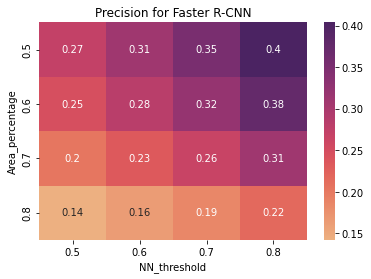

In [376]:
cmap = sns.color_palette("flare", as_cmap=True)

ax = plt.axes()
sns.heatmap(Precision, annot=True, cmap=cmap, ax=ax)
ax.set_title('Precision for Faster R-CNN')
plt.show()

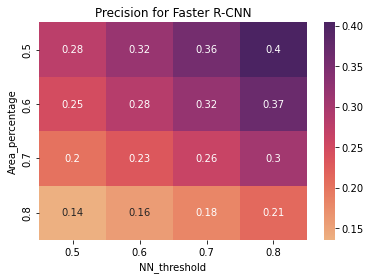

In [392]:
cmap = sns.color_palette("flare", as_cmap=True)

ax = plt.axes()
sns.heatmap(Precision, annot=True, cmap=cmap, ax=ax)
ax.set_title('Precision for Faster R-CNN')
plt.show()

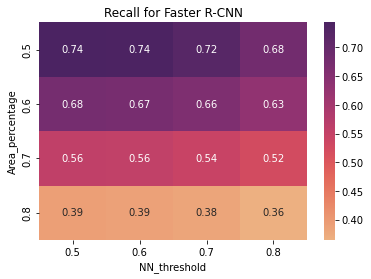

In [377]:
cmap = sns.color_palette("flare", as_cmap=True)

ax = plt.axes()
sns.heatmap(Recall, annot=True, cmap=cmap, ax=ax)
ax.set_title('Recall for Faster R-CNN')
plt.show()

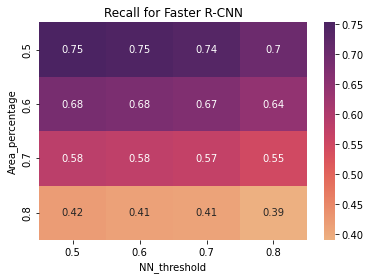

In [418]:
cmap = sns.color_palette("flare", as_cmap=True)

ax = plt.axes()
sns.heatmap(Precision, annot=True, cmap=cmap, ax=ax)
ax.set_title('Recall for Faster R-CNN')
plt.show()

In [412]:
def recall_normalization(p_df, gt_df):
    frame_num = int(p_df['frame_number'].values[0])
    g_df = gt_df[gt_df['frame_number']==frame_num]
    L = g_df.shape[0]
    if L != 0:
        return sum(p_df.Recognized)/L
    else:
        return np.nan
        
    

In [428]:
GT_df

,x1,y1,x2,y2,classId,frame_number,Area,Recognized,NN_threshold,Area_percentage
0,249.141968,86.870743,266.399994,97.800003,car,30,188.617459,False,0.5,0.5
1,236.600000,94.700000,253.000000,109.600000,car,50,244.360000,False,0.5,0.6
2,228.000000,95.500000,247.600000,111.900000,car,60,321.440000,False,0.5,0.7
3,213.924103,97.827415,236.600006,118.199997,car,70,461.966688,False,0.5,0.8
4,541.058960,178.437210,600.000000,230.100006,car,70,3045.058929,False,0.5,0.5
...,...,...,...,...,...,...,...,...,...,...
346,403.317993,123.653854,426.000000,139.300003,truck,1730,354.886051,False,0.5,0.7
347,393.926544,115.827660,415.100006,134.600006,truck,1740,397.475564,False,0.5,0.8
348,387.665588,114.262421,404.100006,126.800003,truck,1750,206.047866,False,0.5,0.5
349,382.200000,110.400000,395.500000,122.900000,truck,1760,166.250000,False,0.5,0.6


In [417]:
Recall = PRED_df.groupby(['NN_threshold','Area_percentage','frame_number']).apply(lambda x : sum(x.Recognized)/x.shape[0]).to_frame()
Recall = Recall.groupby(['NN_threshold','Area_percentage']).mean()
Recall = Recall.reset_index().pivot(columns='NN_threshold',index='Area_percentage',values=0)
Recall.columns = pd.Series([0.5,0.6,0.7,0.8], name = 'NN_threshold')
Recall.index = pd.Series([0.5,0.6,0.7,0.8], name = 'Area_percentage')

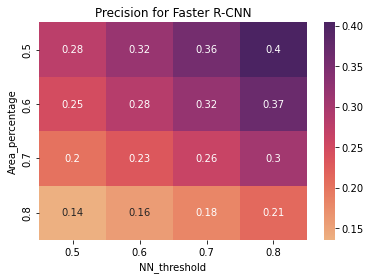

In [391]:
cmap = sns.color_palette("flare", as_cmap=True)

ax = plt.axes()
sns.heatmap(Precision, annot=True, cmap=cmap, ax=ax)
ax.set_title('Precision for Faster R-CNN')
plt.show()